<a href="https://colab.research.google.com/github/Vasiliki655/DSC511-Introduction/blob/main/Copy_of_DSC_511_Project_Combined1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# DSC 511 - Big Data Analytics - Group Semester Project
## Reviews of restaurants for pre and post-Covid-19 periods
### Spring Semester 2025
##### Team: Rafaela Christou, Emili Rousou, Christiana Zorzi, Vasiliki Christodoulou

## Loading libraries

In [1]:
# Installing pyspark
! pip3 install pyspark

In [2]:
# Importing Libraries
import matplotlib.pyplot as plt
from pyspark.sql import SparkSession
from pyspark.sql.functions import *
import seaborn as sns
from google.colab import drive
from pyspark.sql.functions import lower, regexp_replace
from pyspark.sql.window import Window
from pyspark.sql.functions import row_number
from pyspark.ml.clustering import LDA
from pyspark.ml.feature import CountVectorizer
from pyspark.ml import Pipeline
from pyspark.ml.feature import IDF
from pyspark.sql.functions import expr
from pyspark.ml.linalg import Vectors, DenseVector
from pyspark.sql.functions import udf
from pyspark.sql.types import ArrayType, DoubleType
from pyspark.sql.functions import avg, count, col

In [3]:
spark = SparkSession.builder \
    .appName("Group_Project_Reviews_Covid") \
    .master("local") \
    .getOrCreate()

## Loading the datasets

In [4]:
# Google drive and reading the csv of post dataset
drive.mount('/content/gdrive')
google_drive_path = "/content/gdrive/MyDrive/postcovid_reviews.csv"

Mounted at /content/gdrive


In [5]:
# Google drive and reading the csv of pre dataset
drive.mount('/content/gdrive')
google_drive = "/content/gdrive/MyDrive/precovid_reviews.csv"

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [16]:
post_df = spark.read.options(header='True', inferSchema='True', delimiter=',',multiline = True, escape = '"').csv(google_drive_path)
parquet_path_post = "/content/gdrive/MyDrive/post_parquet"
post_df.write.mode('overwrite').parquet(parquet_path_post)
post_df = spark.read.parquet("/content/gdrive/MyDrive/post_parquet")

In [7]:
post_df = spark.read.options(header='True', inferSchema='True', delimiter=',',multiline = True, escape = '"').csv(google_drive_path)
post_df.write.mode('overwrite').parquet('/tmp/my_data_parquet')
post_df = spark.read.parquet('/tmp/my_data_parquet')

In [17]:
post_df.show(10)

+--------------------+--------------------+--------------------+------+------------+-----------+-------------+--------------+-----+------------+-------+--------------------+--------------------+--------------------+--------------------+--------------+------+-----+----+--------------------+-------------------+
|         business_id|                name|             address|state_|        city|postal_code|     latitude|     longitude|stars|review_count|is_open|          categories|               hours|           review_id|             user_id|customer_stars|useful|funny|cool|               text_|              date_|
+--------------------+--------------------+--------------------+------+------------+-----------+-------------+--------------+-----+------------+-------+--------------------+--------------------+--------------------+--------------------+--------------+------+-----+----+--------------------+-------------------+
|2WRCcQATOe_Em0k61...|Yook Korean Grill...| 2408 Nanaimo Street|   

In [8]:
pre_df = spark.read.options(header='True', inferSchema='True', delimiter=',',multiline = True, escape = '"').csv(google_drive)
pre_df.write.mode('overwrite').parquet('/tmp/my_data_parquet')
pre_df = spark.read.parquet('/tmp/my_data_parquet')

In [ ]:
pre_df = spark.read.options(header='True', inferSchema='True', delimiter=',',multiline = True, escape = '"').csv(google_drive)
parquet_path_pre = "/content/gdrive/MyDrive/pre_parquet"
pre_df.write.mode('overwrite').parquet(parquet_path_pre)
pre_df = spark.read.parquet("/content/gdrive/MyDrive/pre_parquet")

## Data Preprocessing

Checking for missing values


In [ ]:
# check for missing values
pre_df = pre_df.replace("NULL", None)
pre_df.select([sum(col(c).isNull().cast("int")).alias(c) for c in pre_df.columns]).show()

+-----------+----+-------+------+----+-----------+--------+---------+-----+------------+-------+----------+------+---------+-------+--------------+------+-----+----+-----+-----+
|business_id|name|address|state_|city|postal_code|latitude|longitude|stars|review_count|is_open|categories| hours|review_id|user_id|customer_stars|useful|funny|cool|text_|date_|
+-----------+----+-------+------+----+-----------+--------+---------+-----+------------+-------+----------+------+---------+-------+--------------+------+-----+----+-----+-----+
|          0|   0|  13409|     0|   0|        384|       0|        0|    0|           0|      0|         0|216501|        0|      0|             0|     0|    0|   0|    1|    0|
+-----------+----+-------+------+----+-----------+--------+---------+-----+------------+-------+----------+------+---------+-------+--------------+------+-----+----+-----+-----+



In [ ]:
# check for missing values
post_df = post_df.replace("NULL", None)
post_df.select([sum(col(c).isNull().cast("int")).alias(c) for c in post_df.columns]).show()

+-----------+----+-------+------+----+-----------+--------+---------+-----+------------+-------+----------+-----+---------+-------+--------------+------+-----+----+-----+-----+
|business_id|name|address|state_|city|postal_code|latitude|longitude|stars|review_count|is_open|categories|hours|review_id|user_id|customer_stars|useful|funny|cool|text_|date_|
+-----------+----+-------+------+----+-----------+--------+---------+-----+------------+-------+----------+-----+---------+-------+--------------+------+-----+----+-----+-----+
|          0|   0|    992|     0|   0|          4|       0|        0|    0|           0|      0|         0|12232|        0|      0|             0|     0|    0|   0|    0|    0|
+-----------+----+-------+------+----+-----------+--------+---------+-----+------------+-------+----------+-----+---------+-------+--------------+------+-----+----+-----+-----+



Both datasets have some missing values in address,hours and postal code columns.
Since we will mostly focus on the reviews we decided to not drop them.
Only the one missing review was removed.

In [ ]:
pre_df = pre_df.dropna(subset=["text_"])

Removing duplicated reviews

In [ ]:
# Checking for duplicated values
print(pre_df.count())
pre_df = pre_df.dropDuplicates()
print(pre_df.count())
# there are no duplicated rows

5172198
5172198


In [ ]:
# Checking for duplicated values
print(post_df.count())
post_df = post_df.dropDuplicates()
print(post_df.count())
# there are no duplicated rows

400295
400295


In [ ]:
# Drop duplicate reviews (same user, business, and text)
post_df = post_df.dropDuplicates(["user_id", "business_id", "text_"])
post_df.count()
# Number of rows before removing duplicated reviews: 400295

399826

In [ ]:
# Drop duplicate reviews (same user, business, and text)
pre_df = pre_df.dropDuplicates(["user_id", "business_id", "text_"])
pre_df.count()
# Number of rows before removing duplicated reviews: 5172198

5163366

Date Range of Post and Pre Covid dataset

In [ ]:
print('Date Range Pre-Covid:', pre_df.select(min('date_')).collect()[0][0], '-', pre_df.select(max('date_')).collect()[0][0])
print('Date Range Post-Covid:', post_df.select(min('date_')).collect()[0][0], '-', post_df.select(max('date_')).collect()[0][0])

Date Range Pre-Covid: 2004-10-13 00:03:20 - 2019-12-30 23:59:16
Date Range Post-Covid: 2020-01-01 00:00:01 - 2021-01-27 23:59:54


 The first American case was reported on January 20, and Health and Human Services Secretary Alex Azar declared a public health emergency on January 31.
 https://en.wikipedia.org/wiki/COVID-19_pandemic_in_the_United_States

In [ ]:
pre_covid_reviews = post_df.filter(col("date_")< to_timestamp(lit("2020-01-20 00:00:01")))
pre_covid_reviews.count()

31633

 There are 31633 reviews that were written before 20/01,which was when the first covid case was reported in America

Removing those reviews from the post covid dataset

In [ ]:
post_df =post_df.filter(col("date_") >= to_timestamp(lit("2020-01-20 00:00:01")))
post_df.count()

368193

Adding those reviews in the pre covid dataset

In [ ]:
pre_df = pre_df.union(pre_covid_reviews)
pre_df.show()

+--------------------+--------------------+--------------------+------+----------+-----------+------------------+-------------------+-----+------------+-------+--------------------+--------------------+--------------------+--------------------+--------------+------+-----+----+--------------------+-------------------+
|         business_id|                name|             address|state_|      city|postal_code|          latitude|          longitude|stars|review_count|is_open|          categories|               hours|           review_id|             user_id|customer_stars|useful|funny|cool|               text_|              date_|
+--------------------+--------------------+--------------------+------+----------+-----------+------------------+-------------------+-----+------------+-------+--------------------+--------------------+--------------------+--------------------+--------------+------+-----+----+--------------------+-------------------+
|WwUkt_i82xhQASXP8...|          Seasons 52|

Checking if each business id has a unique name

In [ ]:
print('unique names:', pre_df.select("name").distinct().count())
print('unique ids:', pre_df.select('business_id').distinct().count())

unique names: 36260
unique ids: 49404


In [ ]:
print('unique names:', post_df.select("name").distinct().count())
print('unique ids:', post_df.select('business_id').distinct().count())

unique names: 21595
unique ids: 30061


### Location - Preprocessing - Post df

In [ ]:
# Printing unique Cities
post_df.select(col("city")).distinct().count()

394

As we can notice at first the post covid dataset contained 394 distinct cities, but with a detailed inspection we observed that there was similar cities just written differentlty.

In [ ]:
# Let's clean and normalize city column
# Converting the first letters to capital ones and by using trim we remove
# extra spaces
# initcamp convert the column to title case, where the first letter is always capital
post_df=post_df.withColumn("city",initcap(trim(col("city"))))
post_df.show()

+--------------------+--------------------+--------------------+------+------------+-----------+-------------+--------------+-----+------------+-------+--------------------+--------------------+--------------------+--------------------+--------------+------+-----+----+--------------------+-------------------+
|         business_id|                name|             address|state_|        city|postal_code|     latitude|     longitude|stars|review_count|is_open|          categories|               hours|           review_id|             user_id|customer_stars|useful|funny|cool|               text_|              date_|
+--------------------+--------------------+--------------------+------+------------+-----------+-------------+--------------+-----+------------+-------+--------------------+--------------------+--------------------+--------------------+--------------+------+-----+----+--------------------+-------------------+
|2WRCcQATOe_Em0k61...|Yook Korean Grill...| 2408 Nanaimo Street|   

In [ ]:
post_df.select(col("city")).distinct().count()

We can notice that the unique cities
are reduced to 360.

In [ ]:
# Removing any punctuations and extra spaces for comparison
# e.g. St.Cloud now will be stcloud
from pyspark.sql.functions import lower, regexp_replace

post_df = post_df.withColumn("city_key", lower(regexp_replace(col("city"), r"[^a-zA-Z0-9]", "")))


In [ ]:
# Let's see how many cities we have with the same key
post_df.groupBy("city_key", "city").count().orderBy("city_key").show(360, truncate=False)

+---------------------+-----------------------+-----+
|city_key             |city                   |count|
+---------------------+-----------------------+-----+
|acworth              |Acworth                |2    |
|alafaya              |Alafaya                |103  |
|alamontesprings      |Alamonte Springs       |7    |
|allston              |Allston                |1075 |
|aloha                |Aloha                  |331  |
|aloma                |Aloma                  |19   |
|altamontesprings     |Altamonte Springs      |1888 |
|andover              |Andover                |12   |
|apopka               |Apopka                 |753  |
|arlington            |Arlington              |629  |
|arvada               |Arvada                 |2    |
|ashville             |Ashville               |14   |
|atlanta              |Atlanta                |48363|
|auburndale           |Auburndale             |19   |
|austell              |Austell                |1    |
|austin               |Austi

In [ ]:
from pyspark.sql.window import Window
from pyspark.sql.functions import row_number

# Creating window to rank cities by count per city_key
# For each group of rows with the same city_key sort them by how often they appear
# By using window we create a subset of dataframe where all rows have the same key
# and within each window rows are ordered by the count in descending order
windowSpec = Window.partitionBy("city_key").orderBy(col("count").desc())

# Counting how many times city name appears per city
city_counts = post_df.groupBy("city_key", "city").count()

# Picking the most common city_clean for each city_key
standard_cities = city_counts.withColumn("rank", row_number().over(windowSpec)).filter(col("rank") == 1)

### Now we have a standarized column, e.g. stcloud-> St. Cloud
#### we don't have multiple variations like stcloud, St.  Cloud and St.CLoud etc

#### Explanation of window
https://spark.apache.org/docs/latest/api/python/reference/pyspark.sql/api/pyspark.sql.Window.html


Break data into groups based on city key (all rows same city key are groupped together).

In [ ]:
# Renaming the selected column
standard_cities = standard_cities.withColumnRenamed("city", "city_standardized")

# Preforming join to have a final dataframe
post_df = post_df.join(
    standard_cities.select("city_key", "city_standardized"),
    on="city_key",
    how="left"
)


In [ ]:
# Dropping city key and city columns, because they are not useful
post_df=post_df.drop("city_key", "city")

In [ ]:
post_df.show()

+--------------------+--------------------+--------------------+------+-----------+-------------+--------------+-----+------------+-------+--------------------+--------------------+--------------------+--------------------+--------------+------+-----+----+--------------------+-------------------+-----------------+
|         business_id|                name|             address|state_|postal_code|     latitude|     longitude|stars|review_count|is_open|          categories|               hours|           review_id|             user_id|customer_stars|useful|funny|cool|               text_|              date_|city_standardized|
+--------------------+--------------------+--------------------+------+-----------+-------------+--------------+-----+------------+-------+--------------------+--------------------+--------------------+--------------------+--------------+------+-----+----+--------------------+-------------------+-----------------+
|2WRCcQATOe_Em0k61...|Yook Korean Grill...| 2408 Nan

In [ ]:
post_df.select("city_standardized").distinct().count()

351

The final unique cities  of our dataset
are 351.

#### City EDA

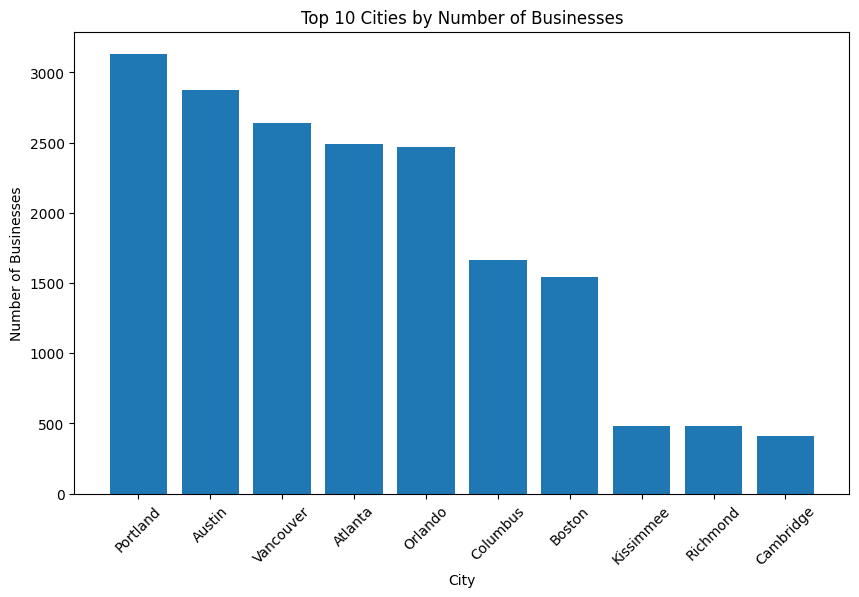

In [ ]:
# Plotting the top 10 cities based on number of business

# Converting post df to pandas
city_counts=post_df.groupBy("city_standardized").agg(countDistinct("business_id").alias("count")).toPandas()
# Sorting and plotting the top 10
top_cities=city_counts.sort_values("count", ascending=False).head(10)

plt.figure(figsize=(10,6))
plt.bar(top_cities["city_standardized"], top_cities["count"])
plt.xticks(rotation=45)

# Setting the labels and the title
plt.title("Top 10 Cities by Number of Businesses")
plt.xlabel("City")
plt.ylabel("Number of Businesses")

# Displaying the plot
plt.show()

The city that contains the most business in the post covid dataset is
Austin, followed by Atlanta, Portland and Orlando.

#### State EDA

In [ ]:
# Finding the unique states
post_df.select(col("state_")).distinct().count()

14

ABE is not a regognized USA state so let's investigate further.

In [ ]:
# Finding rows with ABE state
post_df.filter(col("state_")=="ABE").count()

3

In [ ]:
# Displaying the details for those 3 rows
post_df.filter(col("state_") == "ABE") \
    .select("name", "address", "city_standardized", "postal_code", "latitude", "longitude") \
    .show(truncate=False)

+-------------------+------------------+-----------------+-----------+--------+-----------+
|name               |address           |city_standardized|postal_code|latitude|longitude  |
+-------------------+------------------+-----------------+-----------+--------+-----------+
|Kitanoya Guu Garlic|1698 Robson Street|Vancouver        |V6G 1C7    |49.29065|-123.133761|
|Kitanoya Guu Garlic|1698 Robson Street|Vancouver        |V6G 1C7    |49.29065|-123.133761|
|Kitanoya Guu Garlic|1698 Robson Street|Vancouver        |V6G 1C7    |49.29065|-123.133761|
+-------------------+------------------+-----------------+-----------+--------+-----------+



There is no state called ABE. Actually, the above restauraunts are in the Vancouver, British Columbia, Canada, so the correct province is BC.

In [ ]:
# Changing to the correct province
post_df=post_df.withColumn("state_",
                          when((col("state_") == "ABE") & (col("city_standardized") == "Vancouver"), "BC")
    .otherwise(col("state_"))
)

In [ ]:
# Checking if the changes are applied
post_df.filter(col("state_")=="ABE").count()

0

In [ ]:
post_df.select("state_").distinct().count()

13

In [ ]:
post_df.select("state_").distinct().show()

In conclusion in the post covid dataset we have a total of  13  unique states.

In [ ]:
post_df.groupBy("state_").agg(countDistinct("business_id").alias("business_count")).orderBy("state_", ascending=False).show()

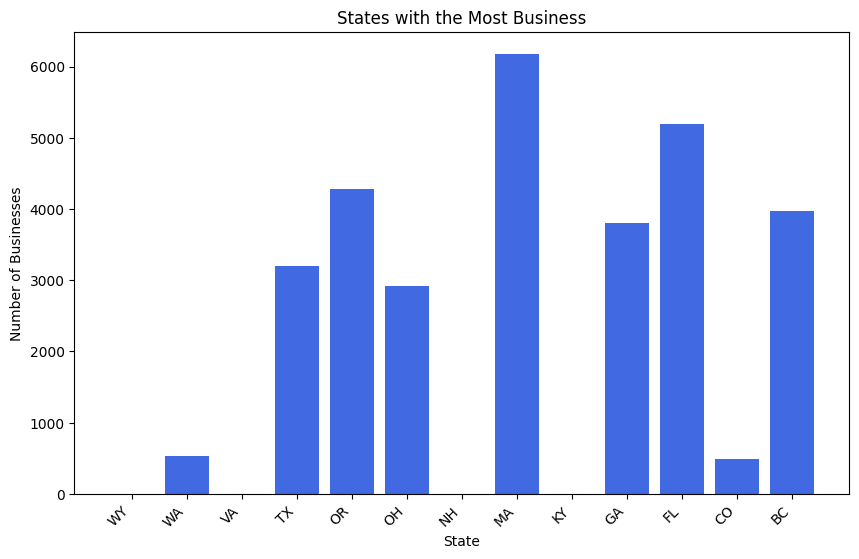

In [ ]:
# Number of Business in Each State
# Counting the business in each state
state_counts=post_df.groupBy("state_").agg(countDistinct("business_id").alias("business_count")).orderBy("state_", ascending=False)
# Top 10 Cities with the most business
top=state_counts.toPandas()

#Plotting
plt.figure(figsize=(10,6))
plt.bar(top['state_'], top['business_count'], color='royalblue')

# Setting title and labels
plt.title("States with the Most Business")
plt.xlabel("State")
plt.ylabel("Number of Businesses")

# Rotating and displaying the plot
plt.xticks(rotation=45, ha='right')
plt.show()

Florida, Massachusetts, Georgia and Texas seems to have the most restauraunts.

In [ ]:
#Total number of reviews for each business in each state
state_reviews=post_df.groupBy("state_", "business_id").agg(sum("review_count").alias("review_count")).orderBy("review_count", ascending=False)

<ipython-input-28-c5d6f295cc9f>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(state_reviews_pd, x="state_", y="review_count", alpha=0.8, palette="summer")


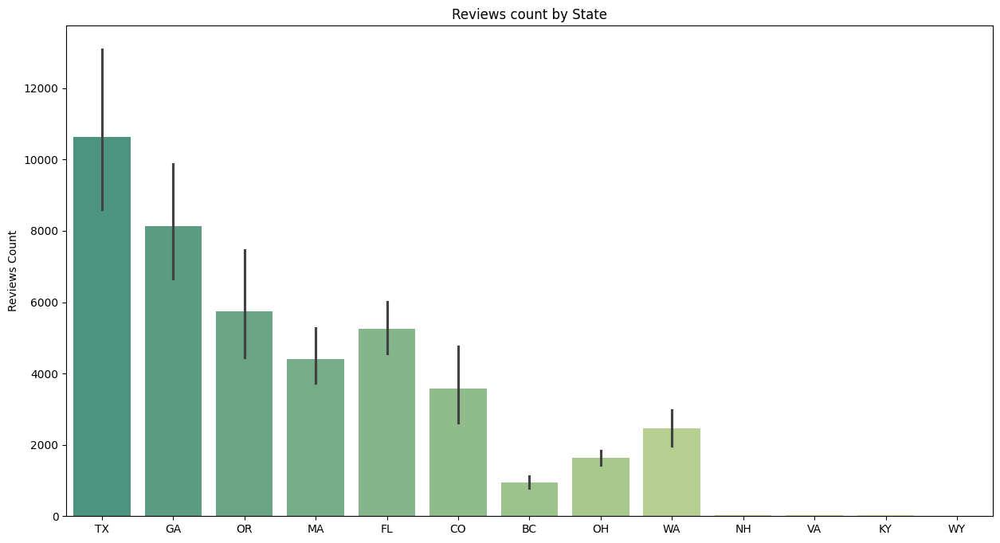

In [ ]:
# Converting to pandas
state_reviews_pd = state_reviews.toPandas()

# Plotting the bar plot
plt.figure(figsize=(15,8))
sns.barplot(state_reviews_pd, x="state_", y="review_count", alpha=0.8, palette="summer")
plt.xlabel("")
plt.ylabel("Reviews Count")
plt.title("Reviews count by State")

# Displaying the plot
plt.show()

The top reviewed states in terms of businesses are Texas, Georgia, Oregon and Florida.

### Location - Preprocessing - Pre df

In [ ]:
# Finding the unique cities
pre_df.select(col("city")).distinct().count()

At a first sight in the pre covid dataset we have a total of 450 cities.
But lets check like before.

Same approach we used in post covid dataframe.

In [ ]:
# Let's clean and normalize city column
# Converting the first letters to capital ones and by using trim we remove
# extra spaces
pre_df=pre_df.withColumn("city",initcap(trim(col("city"))))
pre_df.show()

In [ ]:
# Finding the unique cities
pre_df.select(col("city")).distinct().count()

As we expected the unique cities are reduced. Now we have a total of 415.

In [ ]:
# Removing any punctuations and extra spaces for comparison
# e.g. St.Cloud now will be stcloud or St.  Cloud and St. Cloud are treated
# as two distincts cities

pre_df = pre_df.withColumn("city_key", lower(regexp_replace(col("city"), r"[^a-zA-Z0-9]", "")))

In [ ]:
# Let's see how many cities we have with the same key
pre_df.groupBy("city_key", "city").count().orderBy("city_key").show(360, truncate=False)

In [ ]:
# Creating window to rank cities by count per city_key
# For each group of rows with the same city_key sort them by how often they appear
windowSpec = Window.partitionBy("city_key").orderBy(col("count").desc())

# Counting how many times city name appears per city
city_counts = pre_df.groupBy("city_key", "city").count()

# Picking the most common city_clean for each city_key
standard_cities = city_counts.withColumn("rank", row_number().over(windowSpec)).filter(col("rank") == 1)

### Now we have a standarized column, e.g. stcloud-> St. Cloud

In [ ]:
# Renaming the selected column
standard_cities = standard_cities.withColumnRenamed("city", "city_standardized")

# Preforming join to have a final dataframe
pre_df = pre_df.join(
    standard_cities.select("city_key", "city_standardized"),
    on="city_key",
    how="left"
)


In [ ]:
# Dropping city key and city columns, because they are not useful
pre_df=pre_df.drop("city_key", "city")

In [ ]:
pre_df.select("city_standardized").distinct().count()

The final total number of cities in the pre covid dataframe is 351.

#### City EDA

In [ ]:
# Plotting the top 10 cities based on number of business
import matplotlib.pyplot as plt
# Converting post df to pandas
city_counts=pre_df.groupBy("city_standardized").agg(countDistinct("business_id").alias("count")).toPandas()
# Sorting and plotting the top 10
top_cities=city_counts.sort_values("count", ascending=False).head(10)

plt.figure(figsize=(10,6))
plt.bar(top_cities["city_standardized"], top_cities["count"])
plt.xticks(rotation=45)

# Setting the labels and the title
plt.title("Top 10 Cities by Number of Businesses")
plt.xlabel("City")
plt.ylabel("Number of Businesses")

# Displaying the plot
plt.show()

Still the cities with most businesses are Austin and Portland, followed by Atlanta and Boston.

#### State EDA

In [ ]:
# Finding the unique states
pre_df.select(col("state_")).distinct().count()

The pre covid dataset contains 16 states. Two more than the post covid one.
But let's check like before.

In [ ]:
# Printing Unique States
pre_df.select(col("state_")).distinct().show()

Keeping the same approach with pre covid dataset.

In [ ]:
# Finding rows with ABE state
pre_df.filter(col("state_")=="ABE").count()

In [ ]:
# Displaying the details for those 11 rows
pre_df.filter(col("state_") == "ABE") \
    .select("name", "address", "city_standardized", "postal_code", "latitude", "longitude") \
    .show(truncate=False)

In [ ]:
# Changing to the correct province
pre_df=pre_df.withColumn("state_",
                          when((col("state_") == "ABE") & (col("city_standardized") == "Vancouver"), "BC")
    .otherwise(col("state_"))
)

In [ ]:
# Checking if the changes are applied
pre_df.filter(col("state_")=="ABE").count()

In [ ]:
pre_df.select("state_").distinct().count()

In [ ]:
pre_df.select(col("state_")).distinct().show()

In conclusion we have 13 unique states in the pre dataset.

In [ ]:
state_counts=pre_df.groupBy("state_").agg(countDistinct("business_id").alias("business_count")).orderBy("state_", ascending=False)

In [ ]:
# Number of Business in Each State
# Counting the business in each state

state_counts=pre_df.groupBy("state_").agg(countDistinct("business_id").alias("business_count")).orderBy("state_", ascending=False)
# Top 10 Cities with the most business
top=state_counts.toPandas()

#Plotting
plt.figure(figsize=(10,6))
plt.bar(top['state_'], top['business_count'], color='royalblue')

# Setting title and labels
plt.title("States with the Most Business")
plt.xlabel("State")
plt.ylabel("Number of Businesses")

# Rotating and displaying the plot
plt.xticks(rotation=45, ha='right')
plt.show()

In [ ]:
# Finding NULL string in columns
#post_df = post_df.replace("NULL", None)
pre_df.select([sum(col(c).isNull().cast("int")).alias(c) for c in pre_df.columns]).show()

In [ ]:
#Total number of reviews for each business in each state
state_reviews=pre_df.groupBy("state_", "business_id").agg(sum("review_count").alias("review_count")).orderBy("review_count", ascending=False)

In [ ]:
# Converting to pandas
state_reviews_pd = state_reviews.toPandas()



# Plotting the bar plot
plt.figure(figsize=(15,8))
sns.barplot(state_reviews_pd, x="state_", y="review_count", alpha=0.8, palette="summer")
plt.xlabel("")
plt.ylabel("Reviews Count")
plt.title("Reviews count by State")

# Displaying the plot
plt.show()

The states in the pre covid dataset that contain the most reviews are: Texas, Oregon,Massachusseuts and Georgia.

In [ ]:
import plotly.express as px
# Converting the spark df to pandas

df2=pre_df.select('latitude','longitude', 'stars', 'name').toPandas()

# Calculating the mean latitude and longitude
mean_lat=df2['latitude'].mean()
mean_lon=df2['longitude'].mean()

# Creating the map plot
fig = px.scatter_mapbox(df2,
                        lat='latitude',lon='longitude',
                        zoom=12,
                        width=1000,
                        height=1000,
                        hover_name="name",
                        color="stars",         # Coloring by the stars column (business rating)
                        color_continuous_scale='Viridis',  # Adjusting the color scale
                        center={"lat": mean_lat,"lon": mean_lon}
                        )


# Increasing the size for visibily
fig.update_traces(marker=dict(size=7))
# Setting map style and show the plot
fig.update_layout(
    mapbox_style="open-street-map",
    title='Business Locations on Map (colored by Ratings)'
      )
fig.show(renderer='colab')


#### Hours column

In [18]:
post_df.select("hours").printSchema()

root
 |-- hours: string (nullable = true)



In [19]:
# convert the hours column into dictionary

from pyspark.sql.types import MapType, StringType

# Define the schema for the 'hours' column as a Map[String, String]
schema = MapType(StringType(), StringType())

# Convert the 'hours' column from string to a MapType
post_df = post_df.withColumn("hours", from_json(post_df["hours"], schema))

# Verify the schema
post_df.printSchema()

root
 |-- business_id: string (nullable = true)
 |-- name: string (nullable = true)
 |-- address: string (nullable = true)
 |-- state_: string (nullable = true)
 |-- city: string (nullable = true)
 |-- postal_code: string (nullable = true)
 |-- latitude: double (nullable = true)
 |-- longitude: double (nullable = true)
 |-- stars: double (nullable = true)
 |-- review_count: integer (nullable = true)
 |-- is_open: integer (nullable = true)
 |-- categories: string (nullable = true)
 |-- hours: map (nullable = true)
 |    |-- key: string
 |    |-- value: string (valueContainsNull = true)
 |-- review_id: string (nullable = true)
 |-- user_id: string (nullable = true)
 |-- customer_stars: integer (nullable = true)
 |-- useful: integer (nullable = true)
 |-- funny: integer (nullable = true)
 |-- cool: integer (nullable = true)
 |-- text_: string (nullable = true)
 |-- date_: timestamp (nullable = true)



Count how many businesses have null hours for all days of the week.

In [20]:
## Find records with null values in the hours column or where all days have null values

from pyspark.sql.functions import col, size, map_values

# Filter rows where 'hours' is null or where all values in the 'hours' map are null
df_filtered = post_df.filter(
    (col('hours').isNull()) |  # Check if the 'hours' column is null
    ((size(map_values(col('hours'))) > 0) &  # Check if the map has any entries
     (col('hours').getItem('Monday').isNull() &
      col('hours').getItem('Tuesday').isNull() &
      col('hours').getItem('Wednesday').isNull() &
      col('hours').getItem('Thursday').isNull() &
      col('hours').getItem('Friday').isNull() &
      col('hours').getItem('Saturday').isNull() &
      col('hours').getItem('Sunday').isNull())
    )
)

df_filtered.count()

12232

Define periods:
- Morning: 06:00-12:00
- Afternoon: 12:00-17:00
- Evening: 17:00 -23:00
- LateNight: 23:00- 06:00

In [22]:
from pyspark.sql.functions import col, udf
from pyspark.sql.types import StringType
import datetime

# Define a UDF to categorize the period based on opening and closing times
def categorize_period(opening_closing_str):
    try:
        opening, closing = opening_closing_str.split('-')
        opening_hour, opening_minute = map(int, opening.split(':'))
        closing_hour, closing_minute = map(int, closing.split(':'))

        # Combine the time into a datetime object for comparison
        opening_time = datetime.time(opening_hour, opening_minute)
        closing_time = datetime.time(closing_hour, closing_minute)

        # Define time ranges (assuming the times are in the format "HH:MM")
        if opening_time >= datetime.time(6, 0) and closing_time <= datetime.time(12, 0):
            return 'Morning'
        elif opening_time >= datetime.time(12, 0) and closing_time <= datetime.time(17, 0):
            return 'Afternoon'
        elif opening_time >= datetime.time(17, 0) and closing_time <= datetime.time(23, 0):
            return 'Evening'
        elif closing_time >= datetime.time(23, 0) or opening_time <= datetime.time(6, 0):
            return 'Late Night'
        else:
            return 'Unknown'
    except Exception as e:
        return 'Closed'

# Register UDF with Spark
categorize_period_udf = udf(categorize_period, StringType())

# Add new column 'period' by applying the UDF on each day in the 'hours' map
df_with_period = post_df.withColumn(
    'period_Monday',
    categorize_period_udf(col('hours').getItem('Monday'))  # Example for Monday, repeat for other days if needed
)

df_with_period.show(truncate=False)

+----------------------+--------------------------------+---------------------------------+------+------------+-----------+-------------+--------------+-----+------------+-------+-------------------------------------------------------------------------------------------------------------+------------------------------------------------------------------------------------------------------------------------------------------------------------------+----------------------+----------------------+--------------+------+-----+----+-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

In [23]:
df_with_period = df_with_period.withColumn(
    'period_Tuesday',
    categorize_period_udf(col('hours').getItem('Tuesday'))  # Example for Monday, repeat for other days if needed
)
df_with_period = df_with_period.withColumn(
    'period_Wednesday',
    categorize_period_udf(col('hours').getItem('Wednesday'))  # Example for Monday, repeat for other days if needed
)
df_with_period = df_with_period.withColumn(
    'period_Thursday',
    categorize_period_udf(col('hours').getItem('Thursday'))  # Example for Monday, repeat for other days if needed
)
df_with_period = df_with_period.withColumn(
    'period_Friday',
    categorize_period_udf(col('hours').getItem('Friday'))  # Example for Monday, repeat for other days if needed
)
df_with_period = df_with_period.withColumn(
    'period_Saturday',
    categorize_period_udf(col('hours').getItem('Saturday'))  # Example for Monday, repeat for other days if needed
)
df_with_period = df_with_period.withColumn(
    'period_Sunday',
    categorize_period_udf(col('hours').getItem('Sunday'))  # Example for Monday, repeat for other days if needed
)

In [24]:
from pyspark.sql.functions import col

# Select only columns whose name contains the word 'period'
df_with_period.select([col(column) for column in df_with_period.columns if 'period' in column.lower()]).show(truncate=False)

+-------------+--------------+----------------+---------------+-------------+---------------+-------------+
|period_Monday|period_Tuesday|period_Wednesday|period_Thursday|period_Friday|period_Saturday|period_Sunday|
+-------------+--------------+----------------+---------------+-------------+---------------+-------------+
|Late Night   |Closed        |Unknown         |Unknown        |Unknown      |Unknown        |Unknown      |
|Late Night   |Morning       |Morning         |Morning        |Morning      |Morning        |Morning      |
|Late Night   |Late Night    |Late Night      |Late Night     |Late Night   |Late Night     |Late Night   |
|Unknown      |Unknown       |Unknown         |Morning        |Unknown      |Unknown        |Unknown      |
|Unknown      |Unknown       |Unknown         |Unknown        |Unknown      |Unknown        |Unknown      |
|Late Night   |Late Night    |Late Night      |Late Night     |Morning      |Morning        |Morning      |
|Late Night   |Unknown      

# Exploratory Data Analysis

## Post - Covid Analysis

### Maps of the *restaurants*




In [ ]:
import plotly.express as px
# Converting the spark df to pandas

df2=post_df.select('latitude','longitude', 'stars', 'name').toPandas()

# Calculating the mean latitude and longitude
mean_lat=df2['latitude'].mean()
mean_lon=df2['longitude'].mean()

# Creating the map plot
fig = px.scatter_mapbox(df2,
                        lat='latitude',lon='longitude',
                        zoom=12,
                        width=1000,
                        height=1000,
                        hover_name="name",
                        color="stars",         # Coloring by the stars column (business rating)
                        color_continuous_scale='Viridis',  # Adjusting the color scale
                        center={"lat": mean_lat,"lon": mean_lon}
                        )


# Increasing the size for visibily
fig.update_traces(marker=dict(size=7))
# Setting map style and show the plot
fig.update_layout(
    mapbox_style="open-street-map",
    title='Business Locations on Map (colored by stars)'
      )
fig.show(renderer='colab')

In [ ]:
import plotly.express as px
# Converting the spark df to pandas

df2=post_df.select('latitude','longitude', 'stars', 'name', 'city_standardized', 'is_open').toPandas()

# Calculating the mean latitude and longitude
mean_lat=df2['latitude'].mean()
mean_lon=df2['longitude'].mean()

# Creating the map plot
fig = px.scatter_mapbox(df2,
                        lat='latitude',lon='longitude',
                        zoom=12,
                        width=1000,
                        height=1000,
                        hover_name="name",
                        hover_data=['is_open', 'city_standarized'] ,
                        color="is_open",         # Coloring by the is_open column
                        color_continuous_scale='Viridis',  # Adjusting the color scale
                        center={"lat": mean_lat,"lon": mean_lon}
                        )


# Increasing the size for visibily
fig.update_traces(marker=dict(size=7))
# Setting map style and show the plot
fig.update_layout(
    mapbox_style="open-street-map",
    title='Business Locations on Map (colored by if a restauraunt is open or not)'
      )
fig.show(renderer='colab')


### Stars EDA

<ipython-input-44-fe3a928e3b28>:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




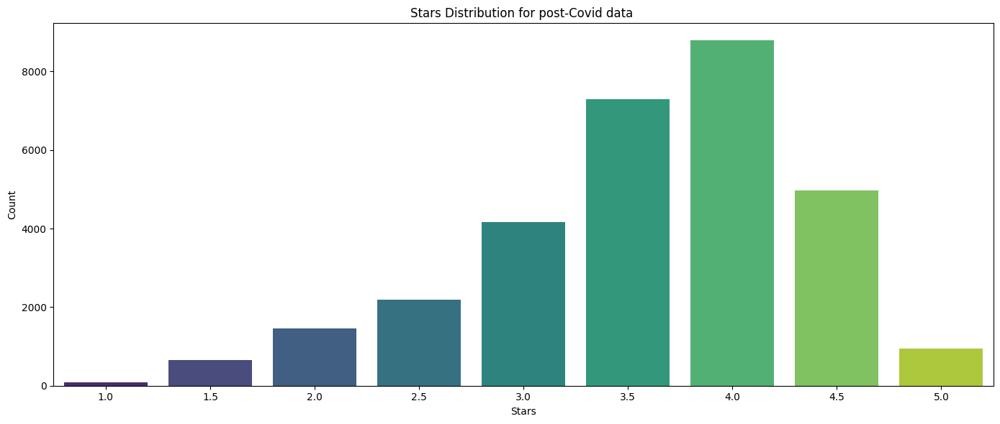

In [ ]:
# Convert the DataFrame to a Pandas DataFrame
#df_stars_post = post_df.select('stars').toPandas()
df_stars_post=post_df.groupBy("stars",'business_id').agg(countDistinct('business_id').alias("count")).toPandas()
# Set up side-by-side plots
fig, ax= plt.subplots(figsize=(14, 6))

# Plot : Distribution of stars from post_df
sns.countplot(x='stars', data=df_stars_post, palette='viridis',
              order=sorted(df_stars_post['stars'].dropna().unique()))
ax.set_title("Stars Distribution for post-Covid data ")
ax.set_xlabel("Stars")
ax.set_ylabel("Count")

plt.tight_layout()
plt.show()

### Open or Closed EDA

<ipython-input-32-39a27a25be24>:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




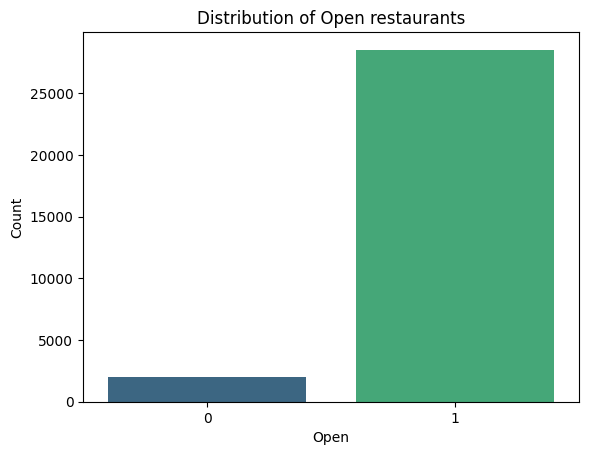

In [ ]:
count_closed_post = post_df.groupBy("is_open").agg(countDistinct('business_id').alias("count"))
sns.barplot(x="is_open",y="count",data=count_closed_post.toPandas(),palette="viridis")
# Add labels and title
plt.xlabel("Open")
plt.ylabel("Count")
plt.title("Distribution of Open restaurants")
plt.show()

### Customer stars EDA

<ipython-input-33-27b216df45ee>:7: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




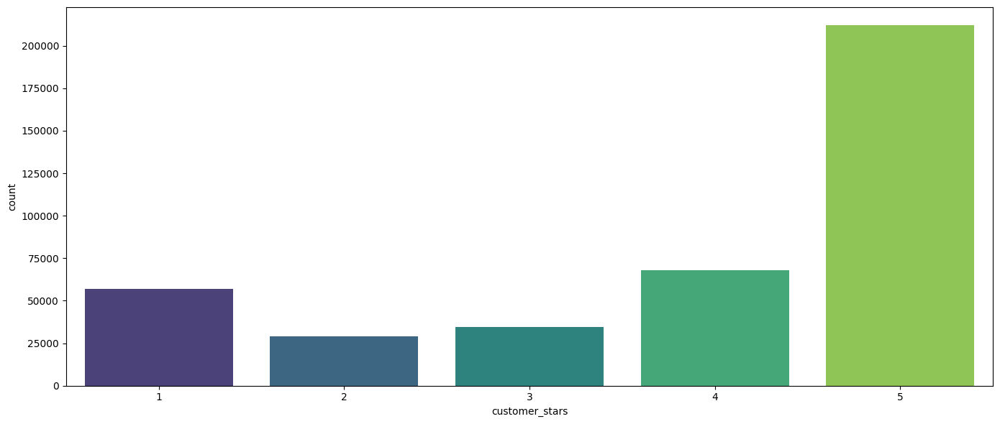

In [ ]:
df_stars_post = post_df.select('customer_stars').toPandas()

# Set up side-by-side plots
fig, axes = plt.subplots(figsize=(14, 6))

# Plot : Distribution of stars from post_df
sns.countplot(x='customer_stars', data=df_stars_post, palette='viridis',
              order=sorted(df_stars_post['customer_stars'].dropna().unique()))
ax.set_title("customer_stars for post-Covid data ")
ax.set_xlabel('customer_stars')
ax.set_ylabel("Count")

plt.tight_layout()
plt.show()

### Useful EDA

<ipython-input-35-a91deaebfe8e>:9: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




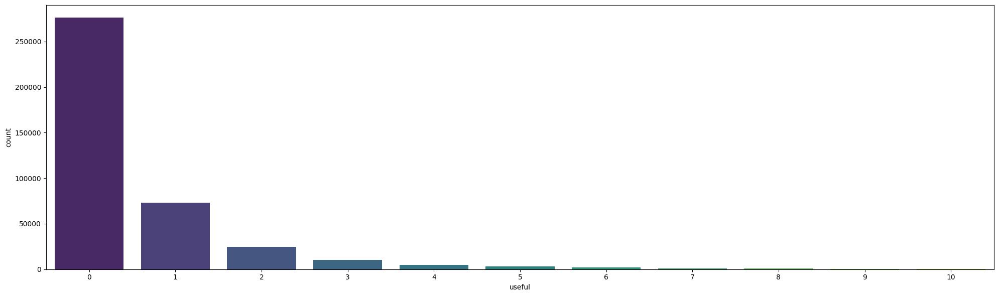

In [ ]:
df_useful_post = post_df.select('useful').toPandas()
# Filter for useful values between 0 and 10
df_useful_post = df_useful_post[df_useful_post['useful'].between(0, 10)]

# Set up side-by-side plots
fig, axes = plt.subplots(figsize=(20, 6))

# Plot : Distribution of stars from post_df
sns.countplot(x='useful', data=df_useful_post, palette='viridis',
              order=sorted(df_useful_post['useful'].dropna().unique()))
ax.set_title("useful for post-Covid data ")
ax.set_xlabel('useful')
ax.set_ylabel("Count")

plt.tight_layout()
plt.show()

### Funny EDA


<ipython-input-36-f66a8569c91e>:9: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




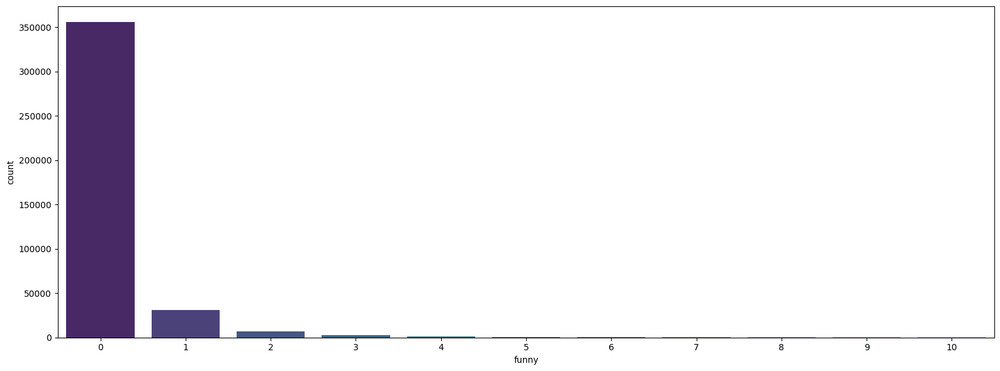

In [ ]:
df_funny_post = post_df.select('funny').toPandas()
# Filter for funny values between 0 and 10
df_funny_post = df_funny_post[df_funny_post['funny'].between(0, 10)]

# Set up side-by-side plots
fig, axes = plt.subplots(figsize=(16, 6))

# Plot : Distribution of stars from post_df
sns.countplot(x='funny', data=df_funny_post, palette='viridis',
              order=sorted(df_funny_post['funny'].dropna().unique()))
ax.set_title("funny for post-Covid data ")
ax.set_xlabel('funny')
ax.set_ylabel("Count")

plt.tight_layout()
plt.show()

### Cool EDA

<ipython-input-38-11bcf09c1559>:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




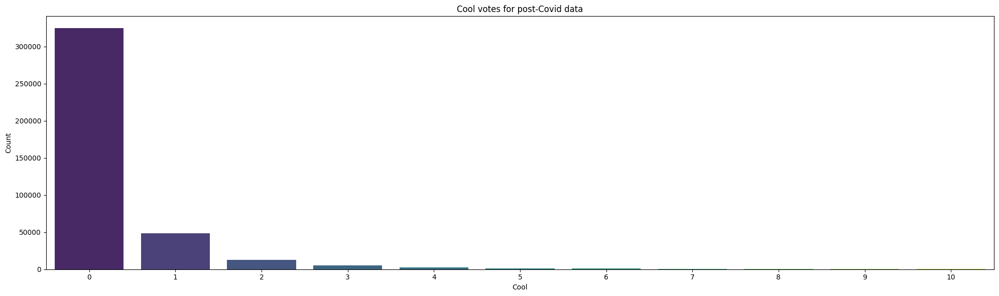

In [ ]:
df_cool_post = post_df.select('cool').toPandas()

# Filter for cool values between 0 and 10
df_cool_post = df_cool_post[df_cool_post['cool'].between(0, 10)]

# Set up the plot
fig, ax = plt.subplots(figsize=(20, 6))

# Plot the distribution
sns.countplot(x='cool', data=df_cool_post, palette='viridis',
              order=sorted(df_cool_post['cool'].dropna().unique()))

# Set labels and title
ax.set_title("Cool votes for post-Covid data")
ax.set_xlabel('Cool')
ax.set_ylabel("Count")

plt.tight_layout()
plt.show()


### Stars EDA

<ipython-input-46-ae7cf3e062ac>:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




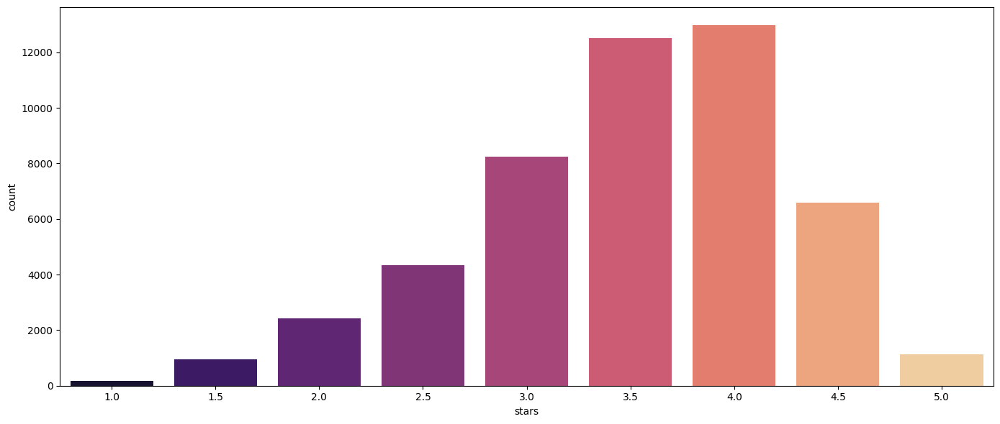

In [ ]:
# Convert the DataFrame to a Pandas DataFrame
#df_stars_pre = pre_df.select('stars').toPandas()
df_stars_pre=pre_df.groupBy("stars",'business_id').agg(countDistinct('business_id').alias("count")).toPandas()
# Set up side-by-side plots
fig, axes = plt.subplots(figsize=(14, 6))

# Plot : Some distribution from other_df
sns.countplot(x='stars', data=df_stars_pre, palette='magma',
              order=sorted(df_stars_pre['stars'].dropna().unique()))
ax.set_title("Stars Distribution for pre-Covid data")
ax.set_xlabel("Stars")
ax.set_ylabel("Count")
ax.tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

## Pre - Covid Analysis

### Open or Closed EDA

<ipython-input-41-a3126d92ec84>:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




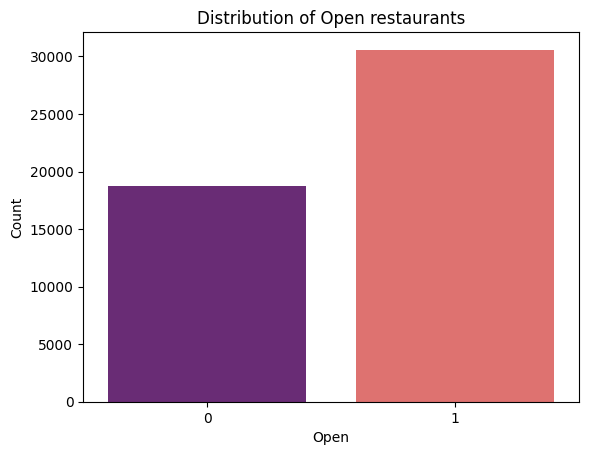

In [ ]:
count_closed_pre = pre_df.groupBy("is_open").agg(countDistinct('business_id').alias("count"))
sns.barplot(x="is_open",y="count",data=count_closed_pre.toPandas(),palette="magma")
# Add labels and title
plt.xlabel("Open")
plt.ylabel("Count")
plt.title("Distribution of Open restaurants")
plt.show()

### Customer Stars EDA

<ipython-input-47-fc3518a3bc0b>:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='customer_stars', data=df_stars_pre, palette='magma',


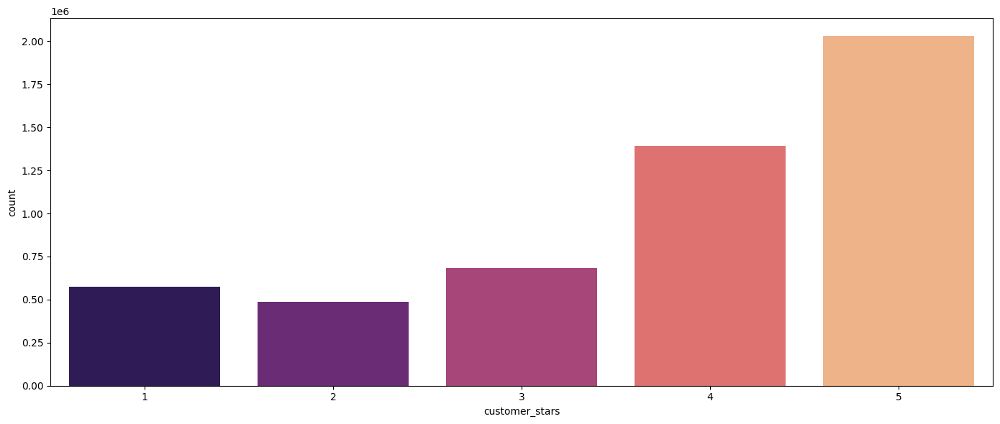

In [ ]:
df_stars_pre = pre_df.select('customer_stars').toPandas()

# Set up side-by-side plots
fig, axes = plt.subplots(figsize=(14, 6))

# Plot : Distribution of stars from pre_df
sns.countplot(x='customer_stars', data=df_stars_pre, palette='magma',
              order=sorted(df_stars_pre['customer_stars'].dropna().unique()))
ax.set_title("customer_stars Distribution for pre-Covid data ")
ax.set_xlabel('customer_stars')
ax.set_ylabel("Count")

plt.tight_layout()
plt.show()

### Useful EDA

<ipython-input-47-110dbe5de786>:9: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




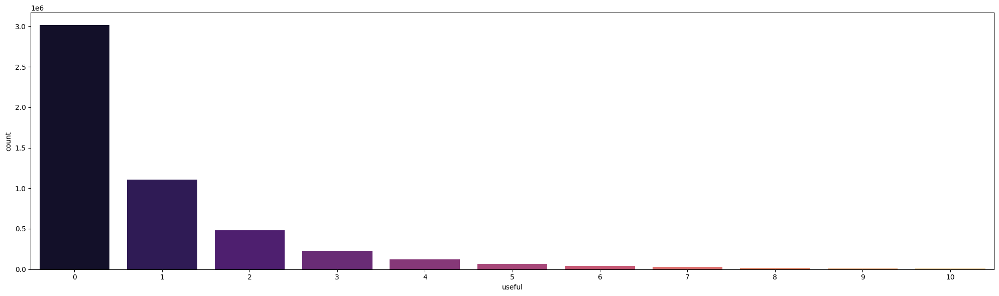

In [ ]:
df_useful_pre = pre_df.select('useful').toPandas()
# Filter for useful values between 0 and 10
df_useful_pre = df_useful_pre[df_useful_pre['useful'].between(0, 10)]

# Set up side-by-side plots
fig, axes = plt.subplots(figsize=(20, 6))

# Plot : Distribution of stars from pre_df
sns.countplot(x='useful', data=df_useful_pre, palette='magma',
              order=sorted(df_useful_pre['useful'].dropna().unique()))
ax.set_title("Useful Distribution for pre-Covid data ")
ax.set_xlabel('useful')
ax.set_ylabel("Count")

plt.tight_layout()
plt.show()

### Funny EDA

<ipython-input-48-dea038c8fea8>:9: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




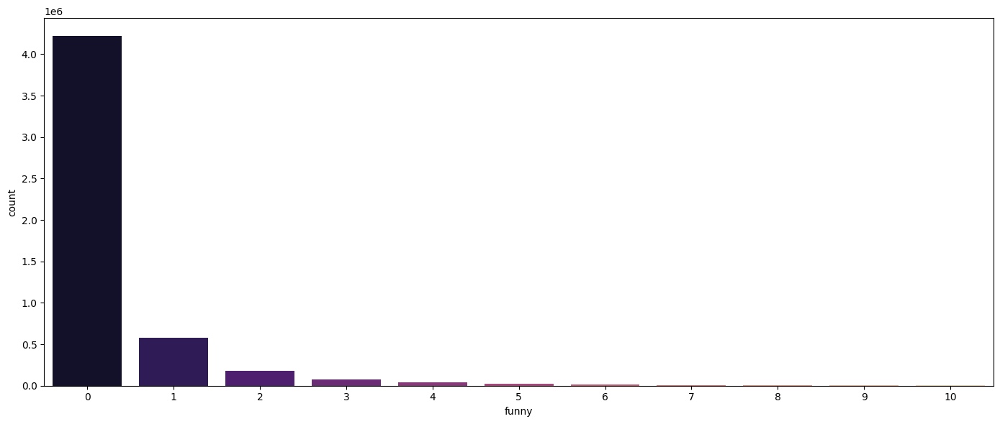

In [ ]:
df_funny_pre = pre_df.select('funny').toPandas()
# Filter for funny values between 0 and 10
df_funny_pre = df_funny_pre[df_funny_pre['funny'].between(0, 10)]

# Set up side-by-side plots
fig, axes = plt.subplots(figsize=(14, 6))

# Plot : Distribution of stars from pre_df
sns.countplot(x='funny', data=df_funny_pre, palette='magma',
              order=sorted(df_funny_pre['funny'].dropna().unique()))
ax.set_title("funny Distribution for pre-Covid data ")
ax.set_xlabel('funny')
ax.set_ylabel("Count")

plt.tight_layout()
plt.show()

### Cool EDA

<ipython-input-49-49bb109d334f>:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




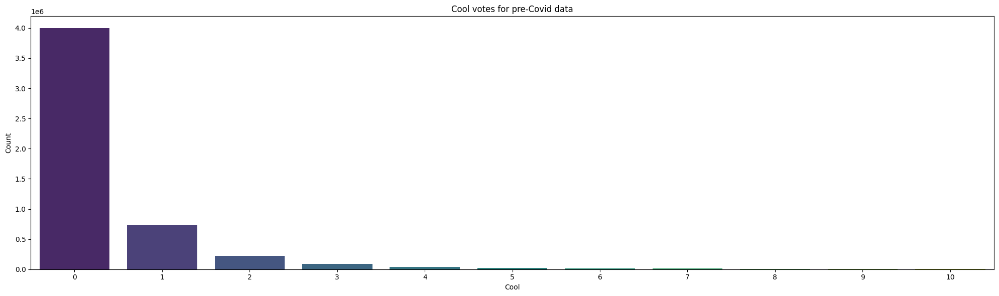

In [ ]:
df_cool_pre = pre_df.select('cool').toPandas()

# Filter for cool values between 0 and 10
df_cool_pre = df_cool_pre[df_cool_pre['cool'].between(0, 10)]

# Set up the plot
fig, ax = plt.subplots(figsize=(20, 6))

# Plot the distribution
sns.countplot(x='cool', data=df_cool_pre, palette='viridis',
              order=sorted(df_cool_pre['cool'].dropna().unique()))

# Set labels and title
ax.set_title("Cool votes for pre-Covid data")
ax.set_xlabel('Cool')
ax.set_ylabel("Count")

plt.tight_layout()
plt.show()


## Comparisons Between Pre and Post Covid

### Top 20 restauraunts pre and post covid based on average stars - CHECK

In [ ]:
# Finding the top restauraunts pre covid based on average stars
top_pre=pre_df.groupby("name").agg(avg("stars").alias("avg_stars_pre")).orderBy("avg_stars_pre", ascending=False).limit(20)

In [ ]:
# Finding the top restauraunts post covid based on average stars
top_post=post_df.groupby("name").agg(avg("stars").alias("avg_stars_post")).orderBy("avg_stars_post", ascending=False).limit(20)

In [ ]:
# Converting it in pandas for plotting
top_pre_pd=top_pre.toPandas()

In [ ]:
# Converting it in pandas for plotting
top_post_pd=top_post.toPandas()

<ipython-input-54-f8738f4df688>:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-54-f8738f4df688>:12: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




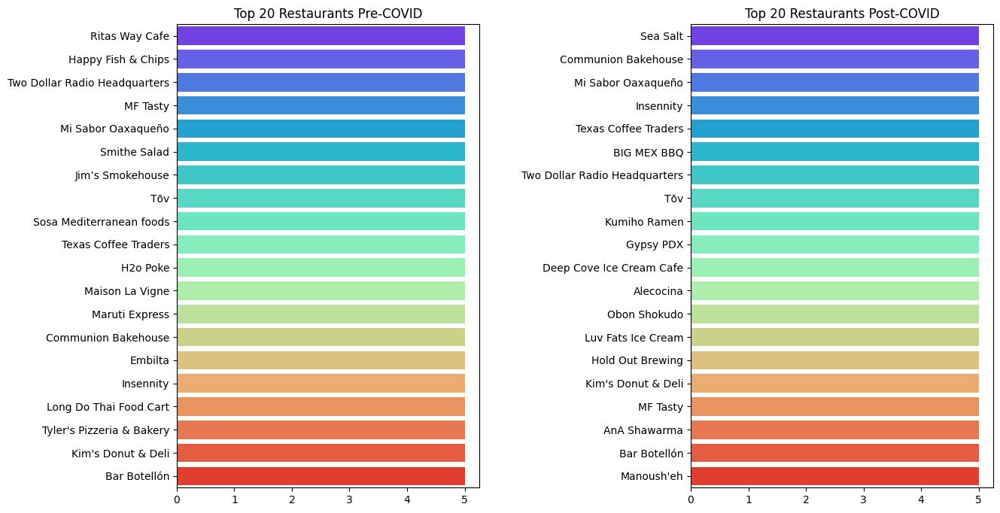

In [ ]:
# Creating subplot layout
f, ax = plt.subplots(1, 2, figsize=(14, 8))
ax1, ax2 = ax.flatten()

# Plotting Pre-COVID top restaurants
sns.barplot(x='avg_stars_pre', y='name', data=top_pre_pd, palette='rainbow', ax=ax1)
ax1.set_title('Top 20 Restaurants Pre-COVID')
ax1.set_xlabel('')
ax1.set_ylabel('')

# Plot Post-COVID top restaurants
sns.barplot(x='avg_stars_post', y='name', data=top_post_pd, palette='rainbow', ax=ax2)
ax2.set_title('Top 20 Restaurants Post-COVID')
ax2.set_xlabel('')
ax2.set_ylabel('')

plt.subplots_adjust(wspace=0.7)
plt.show()


### Average stars and total review count - CHECK

Finding the best restauraunts based the total review count and average stars.

In [ ]:
# Total review count and the average stars for each restauraunt
# Groupping by restaurant name, calculating average stars and displaying the review count
restaurant_ratings_post = post_df.groupBy("name").agg(
    avg("stars").alias("avg_stars_post"),
    sum("review_count").alias("review_count_post")
).orderBy("review_count_post", ascending=False)

# Displaying the result
restaurant_ratings_post.show()

+--------------------+-----------------+-----------------+
|                name|   avg_stars_post|review_count_post|
+--------------------+-----------------+-----------------+
|Terry Black's Bar...|              4.5|          2360520|
|Atlanta Breakfast...|              4.5|          2343103|
|Voodoo Doughnut -...|              3.5|          2094180|
|         Screen Door|              4.5|          1963568|
|       Mike's Pastry|              4.0|          1949038|
|Moonshine Patio B...|              4.5|          1348407|
|   Franklin Barbecue|              4.5|          1324456|
|       Poor Calvin's|              4.5|          1226577|
| Hopdoddy Burger Bar|3.995426829268293|           981162|
|    Café Tu Tu Tango|              4.5|           957856|
|      Neptune Oyster|              4.5|           956505|
|   The Salt Lick BBQ|              4.0|           950040|
|    Home Slice Pizza|              4.5|           874048|
|   Fox Bros. Bar-B-Q|              4.5|           86827

In [ ]:
# Total review count and the average stars for each restauraunt
# Groupping by restaurant name, calculating average stars and displaying the review count
restaurant_ratings = pre_df.groupBy("name").agg(
    avg("stars").alias("avg_stars_pre"),
    sum("review_count").alias("review_count_pre")
).orderBy("review_count_pre", ascending=False)

# Displaying the result
restaurant_ratings.show()

+--------------------+-----------------+----------------+
|                name|    avg_stars_pre|review_count_pre|
+--------------------+-----------------+----------------+
|Voodoo Doughnut -...|              3.5|        83243655|
|       Mike's Pastry|              4.0|        52055510|
|         Screen Door|              4.5|        51384842|
|             Pok Pok|              4.0|        38744388|
|      Neptune Oyster|              4.5|        25733565|
| Hopdoddy Burger Bar|3.996856265535897|        25015115|
|   Franklin Barbecue|              4.5|        23721600|
|Moonshine Patio B...|              4.5|        22323627|
|   The Salt Lick BBQ|              4.0|        19977984|
|Mother’s Bistro &...|              4.5|        19815642|
|Powell's City of ...|              5.0|        18202210|
|    Blue Star Donuts|3.993380855397149|        16832433|
| Pine State Biscuits|4.378276539973788|        15271852|
|       Tasty n Alder|              4.5|        14965250|
| Mary Mac's T

In [ ]:
# Let's join the two dataframes
rest_compare=restaurant_ratings.join(restaurant_ratings_post, on='name', how='inner')

In [ ]:
# Converting to pandas
restaurant_compare_pd=rest_compare.toPandas()

In [ ]:
restaurant_compare_pd

In [ ]:
top_pre=pre_df.filter(col("review_count")>=1000).groupby("name").agg(avg("stars").alias("avg_stars_pre")).orderBy("avg_stars_pre", ascending=False).limit(20)

In [ ]:
from pyspark.sql.functions import avg
top_post=post_df.filter(col("review_count")>=1000).groupby("name").agg(avg("stars").alias("avg_stars_post")).orderBy("avg_stars_post", ascending=False).limit(20)

In [ ]:
top_pre_pd=top_pre.toPandas()

In [ ]:
top_post_pd=top_post.toPandas()

<ipython-input-63-f8738f4df688>:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-63-f8738f4df688>:12: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




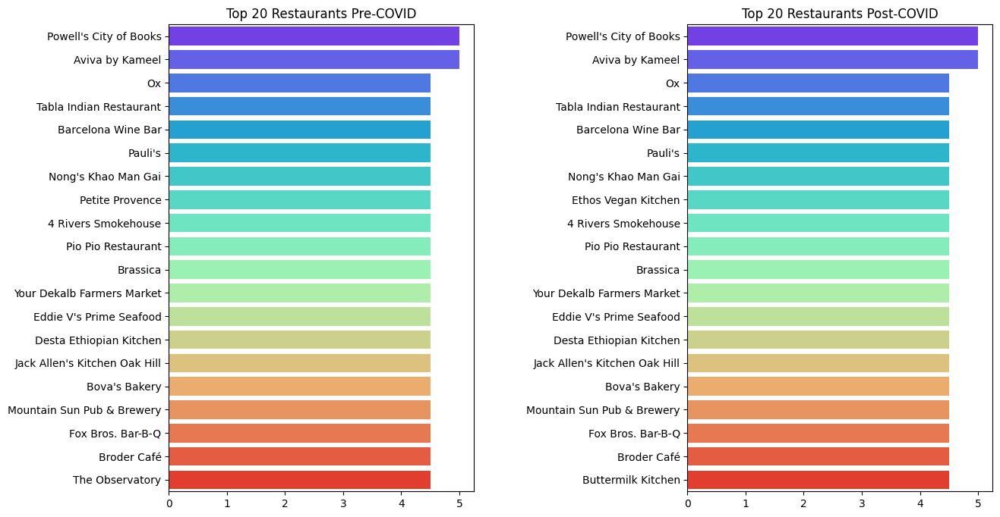

In [ ]:
# Creating subplot layout
f, ax = plt.subplots(1, 2, figsize=(14, 8))
ax1, ax2 = ax.flatten()

# Plotting Pre-COVID top restaurants
sns.barplot(x='avg_stars_pre', y='name', data=top_pre_pd, palette='rainbow', ax=ax1)
ax1.set_title('Top 20 Restaurants Pre-COVID')
ax1.set_xlabel('')
ax1.set_ylabel('')

# Plot Post-COVID top restaurants
sns.barplot(x='avg_stars_post', y='name', data=top_post_pd, palette='rainbow', ax=ax2)
ax2.set_title('Top 20 Restaurants Post-COVID')
ax2.set_xlabel('')
ax2.set_ylabel('')

plt.subplots_adjust(wspace=0.7)
plt.show()

### Review Count Bar Plot

Finding the total review count for each restauraunt pre and post covid

In [ ]:
top_pre1=pre_df.groupby("name").agg(sum("review_count").alias("review_count_pre")).orderBy("review_count_pre", ascending=False).limit(20)

In [ ]:
top_post1=post_df.groupby("name").agg(sum("review_count").alias("review_count_post")).orderBy("review_count_post", ascending=False).limit(20)

In [ ]:
# Converting the dataframes to pandas
top_pre_pd=top_pre1.toPandas()
top_post_pd=top_post1.toPandas()

<ipython-input-67-8116e686ee9a>:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




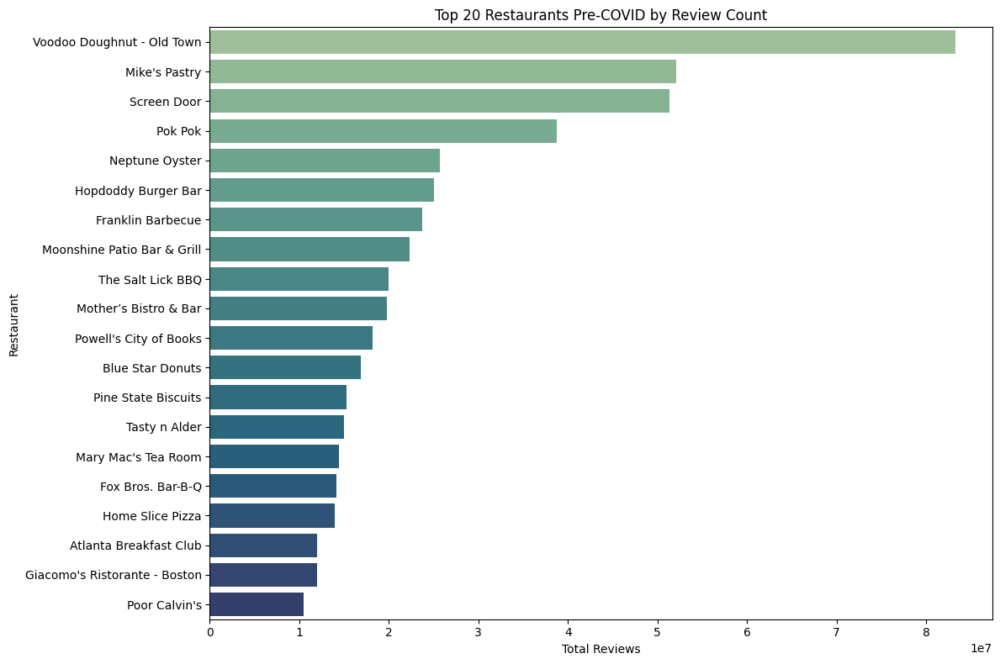

In [ ]:
# Bar plot for pre covid review counts
top_pre_pd = top_pre_pd.sort_values(by='review_count_pre', ascending=False)

# Plot
plt.figure(figsize=(12, 8))
sns.barplot(x='review_count_pre', y='name', data=top_pre_pd, palette='crest')
plt.title('Top 20 Restaurants Pre-COVID by Review Count')
plt.xlabel('Total Reviews')
plt.ylabel('Restaurant')
plt.tight_layout()
plt.show()

<ipython-input-68-5804b778e133>:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




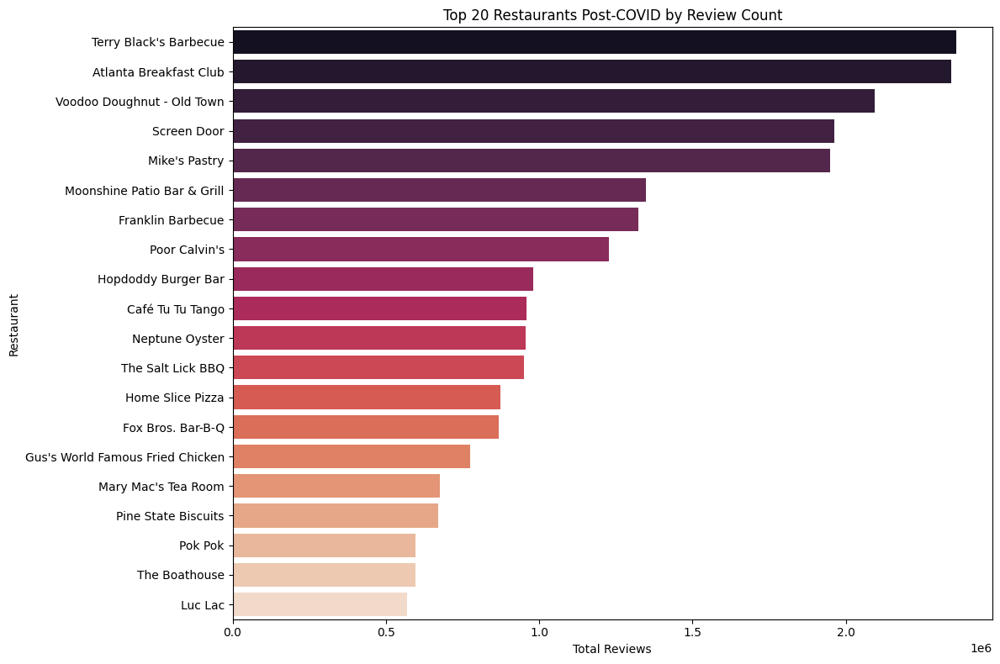

In [ ]:
# Bar plot for post covid review counts
top_post_pd = top_post_pd.sort_values(by='review_count_post', ascending=False)

# Plot
plt.figure(figsize=(12, 8))
sns.barplot(x='review_count_post', y='name', data=top_post_pd, palette='rocket')
plt.title('Top 20 Restaurants Post-COVID by Review Count')
plt.xlabel('Total Reviews')
plt.ylabel('Restaurant')
plt.tight_layout()
plt.show()


The top 5 most reviewed restauraunts changed pre and post covid.
- **Post covid:** Terry Black's Barbecue, Atlanta Breakfast Club, Voodo Doughbut - Old Town, Screen Door and Mike's Pastry
- **Pre covid:** Voodo Doughbut - Old Town,
Mike's Pastry, Screen Door, Pok Pok and Neptune Oyster.

It's obvious that Voodo Doughnut, Screen Door and Mike's Pastry remain on the top 5 across bot periods but after covid Terry Black's Barbecue and Atlanta Breakfasr rose to the top and Pok Pok and Neptune Oyster dropped out of the top 5.

Let's see the customer stars of those restauraunts they changed through covid.

### Customers stars

In [ ]:
c_stars_pre=pre_df.groupby("name").agg(avg("customer_stars").alias("avg_cust_stars_pre"))

In [ ]:
c_stars_post=post_df.groupby("name").agg(avg("customer_stars").alias("avg_cust_stars_post"))

In [ ]:
c_stars_compare = c_stars_pre.join(c_stars_post, on='name', how='inner')

In [ ]:
# Adding the difference
c_stars_compare = c_stars_compare.withColumn(
    "star_change",
    col("avg_cust_stars_post") - col("avg_cust_stars_pre")
)

# Displaying the plots
c_stars_compare.show()

+--------------------+------------------+-------------------+--------------------+
|                name|avg_cust_stars_pre|avg_cust_stars_post|         star_change|
+--------------------+------------------+-------------------+--------------------+
|Applebee's Grill ...|2.3039598438371445|  2.176470588235294|-0.12748925560185054|
|Grindhouse Killer...|3.7732610659439927| 3.8553191489361702| 0.08205808299217754|
|Kiku Japanese Ste...| 2.953846153846154| 2.3461538461538463| -0.6076923076923078|
|       Poor Calvin's| 4.398968739929101|  4.550964187327824| 0.15199544739872284|
|Tokyo Japanese St...|3.0433789954337898|               3.28| 0.23662100456621005|
|Hana Japanese Bistro| 4.317796610169491|                3.8| -0.5177966101694915|
|Austin Kolache & ...| 4.294642857142857|                4.4|  0.1053571428571436|
|          cork&olive|               4.3|                5.0|  0.7000000000000002|
|          Chez Filet| 4.366666666666666|                4.0|-0.36666666666666625|
|   

In [ ]:
# Top 5: increase in stars
# Increase in satisfacrion
c_stars_compare.orderBy("star_change", ascending=False).show(5,truncate=False)

+--------------------------+------------------+-------------------+------------------+
|name                      |avg_cust_stars_pre|avg_cust_stars_post|star_change       |
+--------------------------+------------------+-------------------+------------------+
|Cholo Dogs                |1.0               |5.0                |4.0               |
|Antonio's Pizza & Subs    |1.1428571428571428|5.0                |3.857142857142857 |
|Bud Light Port Paradise   |1.4444444444444444|5.0                |3.5555555555555554|
|JB's Sports Bar and Grille|1.5               |5.0                |3.5               |
|Kawawa Japanese Restaurant|1.5               |5.0                |3.5               |
+--------------------------+------------------+-------------------+------------------+
only showing top 5 rows



We can notice from above a massive improvement in customer satisfaction in those 5 restauraunts.

Selecting only the reviews for the restaurants with the highest improvement in customer stars

In [ ]:
top_5_improved = post_df.filter(post_df.name.isin("Cholo Dogs","Antonio's Pizza & Subs","Bud Light Port Paradise","JB's Sports Bar and Grille","Kawawa Japanese Restaurant"))

In [ ]:
top_5_improved.show()

+--------------------+--------------------+--------------------+------+-----------+----------+------------+-----+------------+-------+--------------------+--------------------+--------------------+--------------------+--------------+------+-----+----+--------------------+-------------------+-----------------+
|         business_id|                name|             address|state_|postal_code|  latitude|   longitude|stars|review_count|is_open|          categories|               hours|           review_id|             user_id|customer_stars|useful|funny|cool|               text_|              date_|city_standardized|
+--------------------+--------------------+--------------------+------+-----------+----------+------------+-----+------------+-------+--------------------+--------------------+--------------------+--------------------+--------------+------+-----+----+--------------------+-------------------+-----------------+
|UMl_5nqGUQExRTm0K...|JB's Sports Bar a...|275 Riverside Pkw...|   

In [ ]:
post_df.filter(col("name") == "Cholo Dogs").select("customer_stars", "text_").show(10,truncate=False)

+--------------+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
|customer_stars|text_                                                                                                                                                                                                                                                                                                                                                                                                                    

In [ ]:
# How many reviews Cholo has
post_df.filter(col("name") == "Cholo Dogs").agg(count("text_").alias("total_reviews")).show()

+-------------+
|total_reviews|
+-------------+
|            6|
+-------------+



In [ ]:
# if we have more than one cholo
post_df.filter(col("name") == "Cholo Dogs").count()

6

In [ ]:
pre_df.filter(col("name") == "Cholo Dogs").select("customer_stars", "text_").show(truncate=False)

+--------------+--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
|customer_stars|text_                                                                                                                                                                                                         |
+--------------+--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
|1             |$6 for a .25c hot dog slathered in spicy mayo sauce. The hot dog guy was funny tho. I feel this is just a money grab with no intention of giving the buyer a quality dog/brat/sausage. Too many other options.|
+--------------+----------------------------------------------------------------------------------------

In [ ]:
pre_df.filter(col("name") == "Cholo Dogs").agg(count("text_").alias("total_reviews")).show()

+-------------+
|total_reviews|
+-------------+
|            1|
+-------------+



In [ ]:
pre_df.filter(col("name") == "Cholo Dogs").agg(sum("review_count").alias("total_reviews")).show()

+-------------+
|total_reviews|
+-------------+
|            7|
+-------------+



In [ ]:
post_df.filter(col("name") == "Cholo Dogs").agg(sum("review_count").alias("total_reviews")).show()

+-------------+
|total_reviews|
+-------------+
|           42|
+-------------+



In [ ]:
# Top 5: decrease in stars
# Decrease in satisfaction
c_stars_compare.orderBy("star_change", ascending=True).show(5,truncate =False)

+----------------------------------+------------------+-------------------+-----------+
|name                              |avg_cust_stars_pre|avg_cust_stars_post|star_change|
+----------------------------------+------------------+-------------------+-----------+
|Super Carniceria Jalisco          |5.0               |1.0                |-4.0       |
|Renaissance Advanced Hair Fashions|5.0               |1.0                |-4.0       |
|Alecomfe Coffee and Restaurant    |5.0               |1.0                |-4.0       |
|Amanecer Coffee Shop & Bakery     |5.0               |1.0                |-4.0       |
|Lua Brazil                        |5.0               |1.0                |-4.0       |
+----------------------------------+------------------+-------------------+-----------+
only showing top 5 rows



In [ ]:
top_5_decrease = post_df.filter(post_df.name.isin("Hindsight Beer Cart","Super Carniceria Jalisco","Alecomfe Coffee and Restaurant","Amanecer Coffee Shop & Bakery","Pho Le 2"))
top_5_decrease.count()

11

In [ ]:
top_5_decrease.show()

+--------------------+--------------------+--------------------+------+-----------+-------------+---------------+-----+------------+-------+--------------------+--------------------+--------------------+--------------------+--------------+------+-----+----+--------------------+-------------------+-----------------+
|         business_id|                name|             address|state_|postal_code|     latitude|      longitude|stars|review_count|is_open|          categories|               hours|           review_id|             user_id|customer_stars|useful|funny|cool|               text_|              date_|city_standardized|
+--------------------+--------------------+--------------------+------+-----------+-------------+---------------+-----+------------+-------+--------------------+--------------------+--------------------+--------------------+--------------+------+-----+----+--------------------+-------------------+-----------------+
|fFwOE7NRAP2395xzi...|Alecomfe Coffee a...|      

In [ ]:
post_df.filter(col("name") == "Hindsight Beer Cart").select("customer_stars", "text_").show(truncate=False)

+--------------+------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
|customer_stars|text_                                                                                                                                                                   |
+--------------+------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
|1             |Good beer but every time I've come to this pod during COVID the employees are unmasked. They've lost my business because of that. We all play a part, please play yours.|
+--------------+------------------------------------------------------------------------------------------------------------------------------------------------------------------------+



In [ ]:
pre_df.filter(col("name") == "Hindsight Beer Cart").select("customer_stars", "text_").show(truncate=False)

+--------------+------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

In [ ]:
pre_df.filter(col("name") == "Hindsight Beer Cart").agg(sum("review_count").alias("total_reviews")).show()

+-------------+
|total_reviews|
+-------------+
|           42|
+-------------+



In [ ]:
post_df.filter(col("name") == "Hindsight Beer Cart").agg(sum("review_count").alias("total_reviews")).show()

+-------------+
|total_reviews|
+-------------+
|            7|
+-------------+



### Highest Satisfaction: Customers Stars

In [ ]:
# Join on restaurant name
c_stars_compare_1 = c_stars_pre.join(c_stars_post, on='name', how='inner')

In [ ]:
c_stars_compare_pd = c_stars_compare_1.toPandas()

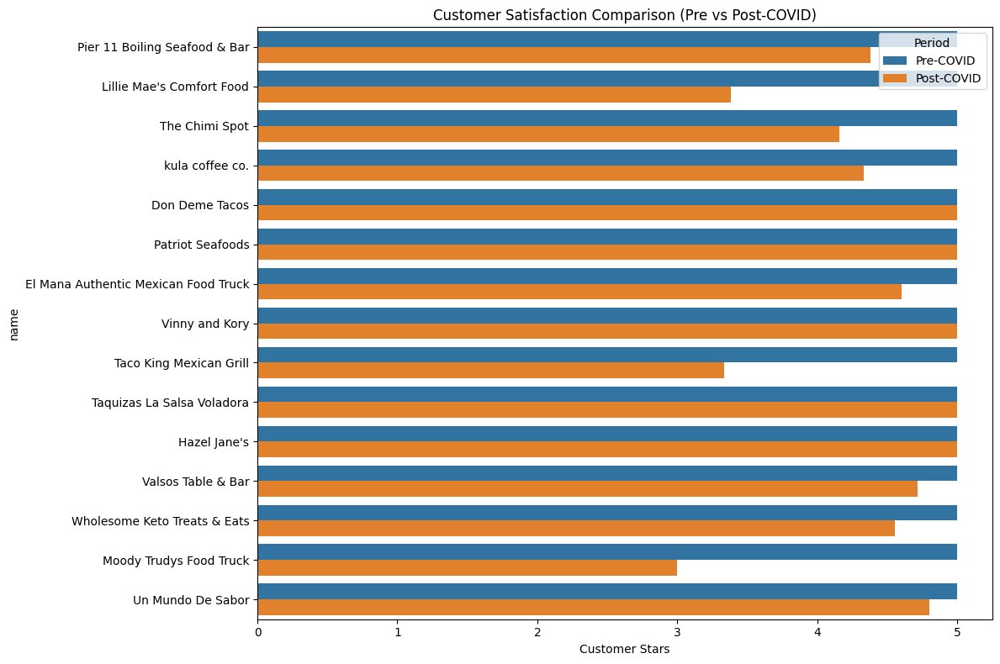

In [ ]:
# Take top 15 restaurants by pre-COVID customer stars
top = c_stars_compare_pd.sort_values(by='avg_cust_stars_pre', ascending=False).head(15)

# Melt for Seaborn plotting
melted = top.melt(id_vars='name',
                  value_vars=['avg_cust_stars_pre', 'avg_cust_stars_post'],
                  var_name='Period',
                  value_name='Customer Stars')

# Clean period labels
melted['Period'] = melted['Period'].replace({
    'avg_cust_stars_pre': 'Pre-COVID',
    'avg_cust_stars_post': 'Post-COVID'
})

# Plot
plt.figure(figsize=(12, 8))
sns.barplot(data=melted, x='Customer Stars', y='name', hue='Period')
plt.title('Customer Satisfaction Comparison (Pre vs Post-COVID)')
plt.tight_layout()
plt.show()


From the above plot we can notice some difference on the customer satisfaction.
By taking into acount only the customer stars, we can see 15 restauraunts and how the stars that customers rate the restauraunts change.
The most big change is obvious in Pho Le 2 Restauraunt. Specifically, Pho Le restauraunt was rated with stars from customer up to 5 before covid but after covid we can notice a clear decrease.

In [ ]:
# Distinct names of restauraunts in post dataset
post_df.select(col("name")).distinct().count()

21923

In [ ]:
pre_df.select(col("name")).distinct().count()

36177

In [ ]:
post_df.select("business_id", "name").distinct().orderBy("business_id").count()

30566

In [ ]:
pre_df.select("business_id", "name").distinct().orderBy("business_id").count()

49301

In [ ]:
c_stars_compare.show()

+--------------------+------------------+-------------------+--------------------+
|                name|avg_cust_stars_pre|avg_cust_stars_post|         star_change|
+--------------------+------------------+-------------------+--------------------+
|Applebee's Grill ...|2.3039598438371445|  2.176470588235294|-0.12748925560185054|
|Grindhouse Killer...|3.7732610659439927| 3.8553191489361702| 0.08205808299217754|
|Kiku Japanese Ste...| 2.953846153846154| 2.3461538461538463| -0.6076923076923078|
|       Poor Calvin's| 4.398968739929101|  4.550964187327824| 0.15199544739872284|
|Tokyo Japanese St...|3.0433789954337898|               3.28| 0.23662100456621005|
|Hana Japanese Bistro| 4.317796610169491|                3.8| -0.5177966101694915|
|Austin Kolache & ...| 4.294642857142857|                4.4|  0.1053571428571436|
|          cork&olive|               4.3|                5.0|  0.7000000000000002|
|          Chez Filet| 4.366666666666666|                4.0|-0.36666666666666625|
|   

In [ ]:
restaurants_declined = c_stars_compare.filter(c_stars_compare.star_change <= -2)
restaurants_declined.show()

+--------------------+------------------+-------------------+-------------------+
|                name|avg_cust_stars_pre|avg_cust_stars_post|        star_change|
+--------------------+------------------+-------------------+-------------------+
|          Pizza King|3.3417721518987342|                1.0|-2.3417721518987342|
|Fatty Cow Seafood...| 3.086021505376344|                1.0| -2.086021505376344|
|       Teriyaki Town| 4.111111111111111|                1.0|-3.1111111111111107|
|      204 Washington|               3.5|                1.0|               -2.5|
|Chi-Town Hot Dogs...| 4.703703703703703|                1.0|-3.7037037037037033|
|   La Bodega Gourmet| 4.507462686567164| 2.3333333333333335| -2.174129353233831|
|Rite Spice Caribbean| 4.379310344827586|                1.0|-3.3793103448275863|
|        Hiraku Sushi| 3.558139534883721|                1.0| -2.558139534883721|
|      Mooyah Burgers|3.4210526315789473|                1.0|-2.4210526315789473|
|Winter Springs 

In [ ]:
# Get list of names from restaurants_declined
declined_names = [row["name"] for row in restaurants_declined.select("name").distinct().collect()]

# Filter post_df by those names
restaurants_declined_post = post_df.filter(col("name").isin(declined_names))

In [ ]:
from pyspark.ml.feature import Tokenizer, StopWordsRemover
restaurants_declined_post  = restaurants_declined_post.withColumn("Reviews",
    regexp_replace(lower(restaurants_declined_post["text_"]), "[^a-zA-Z0-9\s]", ""))

# Remove \n\n and replace with a space
restaurants_declined_post = restaurants_declined_post.withColumn(
    "cleaned_reviews", regexp_replace("Reviews", "\n+", " ")  # Replaces multiple newlines with a space
)

# Tokenize text into words
restaurants_declined_post = restaurants_declined_post.withColumn("words", split("cleaned_reviews", " "))

# Remove stopwords
remover = StopWordsRemover(inputCol="words", outputCol="filtered_words_post")
restaurants_declined_post = remover.transform(restaurants_declined_post)

In [ ]:
from pyspark.ml.clustering import LDA
from pyspark.ml.feature import CountVectorizer
from pyspark.ml import Pipeline
from pyspark.ml.feature import IDF


# Tokenize and remove stopwords (same as before)
cv = CountVectorizer(inputCol="filtered_words_post", outputCol="raw_features", vocabSize=5000, minDF=10.0)
cvmodel = cv.fit(restaurants_declined_post)
result_cv = cvmodel.transform(restaurants_declined_post)
idf = IDF(inputCol="raw_features", outputCol="features")
idfModel = idf.fit(result_cv)
result_tfidf = idfModel.transform(result_cv)

# Apply LDA for topic modeling
lda = LDA(k=10,featuresCol="raw_features",seed=42)
lda_model = lda.fit(result_tfidf)
lda_result = lda_model.transform(result_tfidf)

# Now to print our topics:
topicIndices = lda_model.describeTopics(maxTermsPerTopic = 8)
vocabList = cvmodel.vocabulary

# we print the final topics
for topic in topicIndices.collect():
    print("Topic ID:" + str(topic["topic"]))
    for term in topic["termIndices"]:
        print(vocabList[term])
    print("------------------")

Topic ID:0

menu
pub
keep
food
owners
offer
dont
------------------
Topic ID:1

time
order
place
salad
people
closed
ordered
------------------
Topic ID:2
filling
like
nice
tea
order

made
meat
------------------
Topic ID:3
pork
vegetables
delicious
didnt
us
night
mask
people
------------------
Topic ID:4

food
place
like
one
back
get
dont
------------------
Topic ID:5
la
de
far
got
tell
away
horrible
busy
------------------
Topic ID:6
drinks
minutes
drink
table
waited
service
get
hour
------------------
Topic ID:7
meat
dollars
hard
today
cheese
barely
cold
bowl
------------------
Topic ID:8
business
open
coffee
customer
seems
tip
food
lunch
------------------
Topic ID:9
minutes
45
us
order
5
even
waited
employee
------------------


In [ ]:
from pyspark.sql.functions import expr
from pyspark.ml.linalg import Vectors, DenseVector
from pyspark.sql.functions import udf
from pyspark.sql.types import ArrayType, DoubleType

# UDF to convert vector to array
def to_array(v):
    return v.toArray().tolist()

to_array_udf = udf(to_array, ArrayType(DoubleType()))

# Apply the UDF to get array representation
lda_result_dense = lda_result.withColumn("topic_array", to_array_udf("topicDistribution"))

from pyspark.sql.functions import col

pandemic_reviews = lda_result_dense.filter((col("topic_array")[6] > 0.2) | (col("topic_array")[5] > 0.1))
pandemic_reviews.select("name", "text_").show(truncate=False)

+-------------------------------------------------+------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
|name                                             |te

In [ ]:
pandemic_reviews.show()
# Most common words in pandemic reviews
word_counts = pandemic_reviews.select(explode("filtered_words_post").alias("word")) \
    .groupBy("word").count().orderBy("count", ascending=False)

word_counts.show(30, truncate=False)

+--------------------+--------------------+--------------------+------+-----------+-------------+---------------+-----+------------+-------+--------------------+--------------------+--------------------+--------------------+--------------+------+-----+----+--------------------+-------------------+-----------------+--------------------+--------------------+--------------------+--------------------+--------------------+--------------------+--------------------+--------------------+
|         business_id|                name|             address|state_|postal_code|     latitude|      longitude|stars|review_count|is_open|          categories|               hours|           review_id|             user_id|customer_stars|useful|funny|cool|               text_|              date_|city_standardized|             Reviews|     cleaned_reviews|               words| filtered_words_post|        raw_features|            features|   topicDistribution|         topic_array|
+--------------------+--------

In [ ]:
restaurants_improved = c_stars_compare.filter(c_stars_compare.star_change > 2)
restaurants_improved.show()

+--------------------+------------------+-------------------+------------------+
|                name|avg_cust_stars_pre|avg_cust_stars_post|       star_change|
+--------------------+------------------+-------------------+------------------+
|      Oak Creek Cafe|2.8842105263157896|  4.888888888888889|2.0046783625730997|
|Great Chef Chines...| 2.813953488372093|                5.0| 2.186046511627907|
|       Clamity Jae's| 2.896551724137931|                5.0| 2.103448275862069|
|Johnny M’s Pizza ...|              2.25|                5.0|              2.75|
|       Canton Eatery|2.3866666666666667|                4.6| 2.213333333333333|
|        Lincoln Cafe| 2.840909090909091|                5.0| 2.159090909090909|
|        Union Burger|2.1846153846153844|  4.869565217391305|2.6849498327759203|
|Saugus House of P...| 2.888888888888889|                5.0| 2.111111111111111|
|         Best Buffet| 2.185185185185185|                5.0| 2.814814814814815|
|      Peony Pavilion|2.5714

In [ ]:
# Get list of names from restaurants_improved
improved_names = [row["name"] for row in restaurants_improved.select("name").distinct().collect()]

# Filter post_df by those names
restaurants_improved_post = post_df.filter(col("name").isin(improved_names))

Preprocessing the review column

In [ ]:
restaurants_improved_post  = restaurants_improved_post.withColumn("Reviews",
    regexp_replace(lower(restaurants_improved_post["text_"]), "[^a-zA-Z0-9\s]", ""))

# Remove \n\n and replace with a space
restaurants_improved_post = restaurants_improved_post.withColumn(
    "cleaned_reviews", regexp_replace("Reviews", "\n+", " ")  # Replaces multiple newlines with a space
)

# Tokenize text into words
restaurants_improved_post = restaurants_improved_post.withColumn("words", split("cleaned_reviews", " "))

# Remove stopwords
remover = StopWordsRemover(inputCol="words", outputCol="filtered_words_post")
restaurants_improved_post = remover.transform(restaurants_improved_post)

LDA on the improved restaurants

In [ ]:
from pyspark.ml.clustering import LDA
from pyspark.ml.feature import CountVectorizer
from pyspark.ml import Pipeline
from pyspark.ml.feature import IDF


# Tokenize and remove stopwords (same as before)
cv = CountVectorizer(inputCol="filtered_words_post", outputCol="raw_features", vocabSize=5000, minDF=10.0)
cvmodel = cv.fit(restaurants_improved_post)
result_cv = cvmodel.transform(restaurants_improved_post)
idf = IDF(inputCol="raw_features", outputCol="features")
idfModel = idf.fit(result_cv)
result_tfidf = idfModel.transform(result_cv)

# Apply LDA for topic modeling
lda = LDA(k=10,featuresCol="raw_features",seed=42)
lda_model = lda.fit(result_tfidf)
lda_result = lda_model.transform(result_tfidf)

# Now to print our topics:
topicIndices = lda_model.describeTopics(maxTermsPerTopic = 8)
vocabList = cvmodel.vocabulary

# we print the final topics
for topic in topicIndices.collect():
    print("Topic ID:" + str(topic["topic"]))
    for term in topic["termIndices"]:
        print(vocabList[term])
    print("------------------")

Topic ID:0
friendly
coffee
staff
awesome
tell
see
love
excellent
------------------
Topic ID:1
rice

chicken
good
like
soup
fried
really
------------------
Topic ID:2
made
us
got
bit
decided
local
wasnt
go
------------------
Topic ID:3
day
say
quality
took
nice
new
least
always
------------------
Topic ID:4

place
wasnt
chicken
pizza
staff
coffee
get
------------------
Topic ID:5
soup
bowl
tasty
friendly
bit
good

great
------------------
Topic ID:6
great
burger
meat
burgers
bun
fresh
service
delicious
------------------
Topic ID:7

food
great
place
burger
good
delicious
best
------------------
Topic ID:8
time
good
food
tieu
hu
ordered
rice
definitely
------------------
Topic ID:9
shrimp
seafood
dont
eat
get
wrong
go
bit
------------------


## Categories Column

Top 10 categories pre covid with the most reviews

In [ ]:
pre_df = pre_df.withColumn("category", split(col("categories"), ","))
pre_df.select(explode(col("category")).alias("category")).groupBy("category").count().sort("count",ascending = False,truncate=False).show(10)

+--------------------+-------+
|            category|  count|
+--------------------+-------+
|         Restaurants|3911665|
|                Food|1400728|
|           Nightlife|1347742|
|                Bars|1311984|
|         Restaurants|1283334|
|      American (New)| 810203|
| American (Tradit...| 797334|
|  Breakfast & Brunch| 753445|
|          Sandwiches| 555881|
|             Seafood| 428419|
+--------------------+-------+
only showing top 10 rows



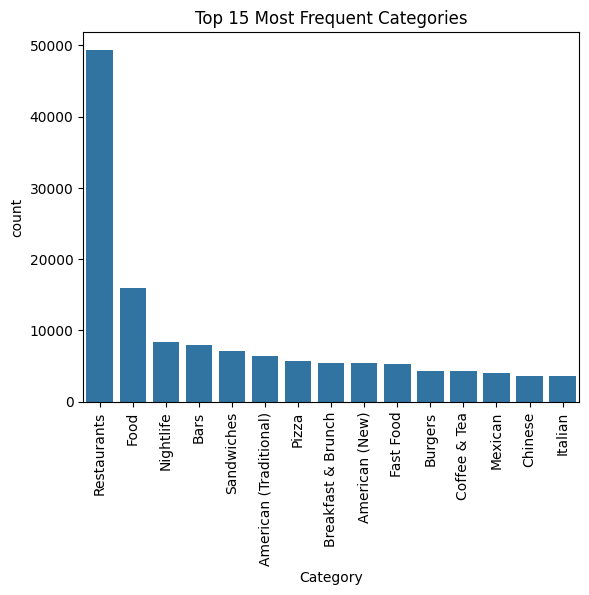

In [ ]:
pre_categories_df = pre_df.withColumn("category", explode(split("categories", ", ")))
top_categories_pre = pre_categories_df.groupBy("category").agg(countDistinct("business_id").alias("count")).orderBy("count", ascending=False)
top_categories = top_categories_pre.limit(15)

#  Convert to pandas for plotting
pandas_df = top_categories.toPandas()

sns.barplot(x="category", y="count", data=pandas_df)
plt.title(f"Top 15 Most Frequent Categories")
plt.xlabel("Category")
plt.xticks(rotation = 90)
plt.show()

Top 10 categories post covid with the most reviews

In [ ]:
post_df = post_df.withColumn("category", split(col("categories"), ","))
post_df.select(explode(col("category")).alias("category")).groupBy("category").count().sort("count",ascending = False,truncate=False).show(10)

+--------------------+------+
|            category| count|
+--------------------+------+
|         Restaurants|275527|
|                Food| 99889|
|         Restaurants| 92666|
|           Nightlife| 82886|
|                Bars| 82014|
|  Breakfast & Brunch| 50173|
| American (Tradit...| 49068|
|      American (New)| 45387|
|          Sandwiches| 38573|
|             Seafood| 31285|
+--------------------+------+
only showing top 10 rows



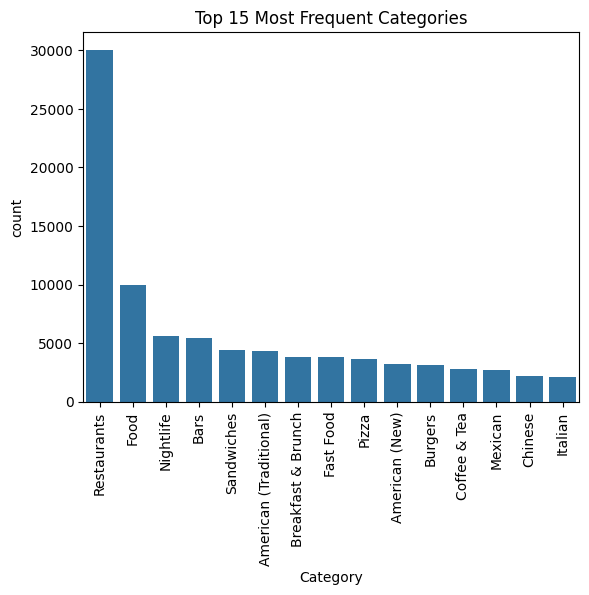

In [ ]:
post_categories_df = post_df.withColumn("category", explode(split("categories", ", ")))
top_categories_post = post_categories_df.groupBy("category").agg(countDistinct("business_id").alias("count")).orderBy("count", ascending=False)
top_categories = top_categories_post.limit(15)

# Convert to pandas for plotting
pandas_df = top_categories.toPandas()
sns.barplot(x="category", y="count", data=pandas_df)
plt.title(f"Top 15 Most Frequent Categories")
plt.xlabel("Category")
plt.xticks(rotation = 90)
plt.show()

Lemmatizing the category column to reduce the number of categories

Tokenizing and lemmatizing the categories column


In [ ]:
# Tokenizing the categories and keeping only word characters
from pyspark.ml.feature import RegexTokenizer
import nltk
nltk.download('wordnet')
# Tokenizing the categories and keeping only word characters
regexTokenizer = RegexTokenizer(inputCol="categories", outputCol="tokenized categories", pattern="\\W")

regexTokenized = regexTokenizer.transform(post_df)

# lemmatization to reduce the number of categories
# Import lemmatizer library
from nltk.stem import WordNetLemmatizer
# Instantiate stemmer object
lemmatizer = WordNetLemmatizer()
# Create lemmatizer python function
def lem(x):
  return [lemmatizer.lemmatize(w) for w in x]

lemmer_udf = udf(lambda x: lem(x), ArrayType(StringType()))
post_lem_df = regexTokenized.withColumn("lemmatized", lemmer_udf("tokenized categories"))
post_lem_df.select("categories","lemmatized").show(truncate=False)

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


+--------------------------------------------------------------------------------------------------------------------------------------+--------------------------------------------------------------------------------------------------------------------------------------+
|categories                                                                                                                            |lemmatized                                                                                                                            |
+--------------------------------------------------------------------------------------------------------------------------------------+--------------------------------------------------------------------------------------------------------------------------------------+
|Indian, Restaurants                                                                                                                   |[indian, restaurant]                            

In [ ]:
# Tokenizing the categories and keeping only word characters
regexTokenizer = RegexTokenizer(inputCol="categories", outputCol="tokenized categories", pattern="\\W")

regexTokenized = regexTokenizer.transform(pre_df)

# lemmatization to reduce the number of categories
# Import lemmatizer library
from nltk.stem import WordNetLemmatizer
# Instantiate stemmer object
lemmatizer = WordNetLemmatizer()
# Create lemmatizer python function
def lem(x):
  return [lemmatizer.lemmatize(w) for w in x]

lemmer_udf = udf(lambda x: lem(x), ArrayType(StringType()))
pre_lem_df = regexTokenized.withColumn("lemmatized", lemmer_udf("tokenized categories"))
pre_lem_df.select("categories","tokenized categories","lemmatized").show(truncate=False)

+---------------------------------------------------------------------------------------------------------------------------------+------------------------------------------------------------------------------------------------------------------------------------+----------------------------------------------------------------------------------------------------------------------------+
|categories                                                                                                                       |tokenized categories                                                                                                                |lemmatized                                                                                                                  |
+---------------------------------------------------------------------------------------------------------------------------------+-----------------------------------------------------------------------------------------

In [ ]:
# Number of unique categories in post_df
post_lem_df.select(explode(col("lemmatized"))).distinct().count()

713

In [ ]:
# Number of unique categories in pre_df
pre_lem_df.select(explode(col("lemmatized"))).distinct().count()

803

In [ ]:
post_lem_df.select(explode(col("lemmatized")).alias("category"),"business_id").groupBy("category").agg(countDistinct("business_id").alias("count")).sort("count",ascending = False,truncate=False).show(10)

+-----------+-----+
|   category|count|
+-----------+-----+
| restaurant|30061|
|       food|13243|
|        bar| 7319|
|   american| 6955|
|  nightlife| 5586|
|   sandwich| 4438|
|traditional| 4298|
|  breakfast| 3844|
|     brunch| 3835|
|       fast| 3789|
+-----------+-----+
only showing top 10 rows



In [ ]:
pre_lem_df.select(explode(col("lemmatized")).alias("category"),"business_id").groupBy("category").agg(countDistinct("business_id").alias("count")).sort("count",ascending = False,truncate=False).show(10)

+-----------+-----+
|   category|count|
+-----------+-----+
| restaurant|49404|
|       food|20802|
|   american|11074|
|        bar|10968|
|  nightlife| 8339|
|   sandwich| 7134|
|traditional| 6435|
|        new| 5751|
|      pizza| 5644|
|  breakfast| 5389|
+-----------+-----+
only showing top 10 rows



In [ ]:
post_categories_df_negative = post_categories_df.filter(col("customer_stars")<3)
post_categories_df_negative.groupBy("category").agg(countDistinct("business_id").alias("count")).orderBy("count", ascending=False).show()

+--------------------+-----+
|            category|count|
+--------------------+-----+
|         Restaurants|21692|
|                Food| 6734|
|           Nightlife| 4167|
|                Bars| 4035|
|American (Traditi...| 3348|
|           Fast Food| 3186|
|          Sandwiches| 3149|
|  Breakfast & Brunch| 2812|
|               Pizza| 2784|
|             Burgers| 2561|
|      American (New)| 2425|
|             Mexican| 2075|
|        Coffee & Tea| 1863|
|             Seafood| 1626|
|             Italian| 1623|
|             Chinese| 1581|
|               Salad| 1500|
|       Chicken Wings| 1355|
|            Japanese| 1271|
|Event Planning & ...| 1225|
+--------------------+-----+
only showing top 20 rows



In [ ]:
post_categories_df_positive = post_categories_df.filter(col("customer_stars") >= 3)
post_categories_df_positive.groupBy("category").agg(countDistinct("business_id").alias("count")).orderBy("count", ascending=False).show()

+--------------------+-----+
|            category|count|
+--------------------+-----+
|         Restaurants|27314|
|                Food| 9067|
|           Nightlife| 5334|
|                Bars| 5155|
|American (Traditi...| 3983|
|          Sandwiches| 3904|
|  Breakfast & Brunch| 3529|
|               Pizza| 3219|
|      American (New)| 3052|
|           Fast Food| 2690|
|             Burgers| 2487|
|             Mexican| 2471|
|        Coffee & Tea| 2352|
|             Chinese| 2039|
|             Italian| 1966|
|             Seafood| 1950|
|               Salad| 1834|
|            Japanese| 1690|
|Event Planning & ...| 1653|
|               Cafes| 1612|
+--------------------+-----+
only showing top 20 rows



In [ ]:
pre_summary = pre_categories_df.groupBy("category") \
    .agg(count("*").alias("pre_reviews"),avg("customer_stars").alias("pre_avg_customer_rating"))

post_summary = post_categories_df.groupBy("category") \
    .agg(count("*").alias("post_reviews"),avg("customer_stars").alias("post_avg_customer_rating"))

# Join pre and post summaries, calculate decline of reviews and rating change
cat_comparison = pre_summary.join(post_summary, on="category", how="outer").fillna(0)

cat_comparison = cat_comparison.withColumn(
    "review_decline_pct",
    round((col("pre_reviews") - col("post_reviews")) / (col("pre_reviews") + 1) * 100, 2)
).withColumn(
    "customer_rating_change",
    round(col("post_avg_customer_rating") - col("pre_avg_customer_rating"), 2)
).withColumn(
    "total_reviews",
    col("pre_reviews") + col("post_reviews")
)

# Filter to categories with more than 10 total reviews and declining review count
declined_cats = cat_comparison.filter(
    (col("total_reviews") > 10) & (col("review_decline_pct") > 0) & (col("post_reviews") >  100)
).orderBy("customer_rating_change", ascending=True)

# Show top declining categories
declined_cats.show(20, truncate=False)

+----------------+-----------+-----------------------+------------+------------------------+------------------+----------------------+-------------+
|category        |pre_reviews|pre_avg_customer_rating|post_reviews|post_avg_customer_rating|review_decline_pct|customer_rating_change|total_reviews|
+----------------+-----------+-----------------------+------------+------------------------+------------------+----------------------+-------------+
|Appliances      |1317       |3.3006833712984056     |122         |2.5081967213114753      |90.67             |-0.79                 |1439         |
|Florists        |3248       |3.7216748768472905     |197         |3.1776649746192893      |93.91             |-0.54                 |3445         |
|Candy Stores    |9720       |4.037551440329218      |633         |3.541864139020537       |93.48             |-0.5                  |10353        |
|Kitchen & Bath  |3337       |3.75786634701828       |226         |3.2964601769911503      |93.2          

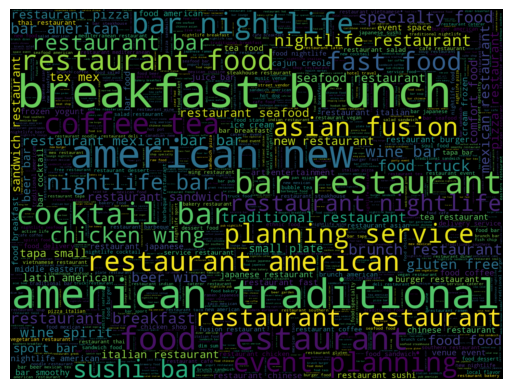

In [ ]:
# Wordcloud of post Covid categories
text_data = ' '.join([item for sublist in post_lem_df.select("lemmatized").rdd.flatMap(lambda x: x).collect() for item in sublist])
#category_counts = Counter(text_data)  # Creates a dictionary: {'Restaurant': 50, 'Cafe': 20, ...}

# Generate WordCloud using frequency data
wordcloud = WordCloud(width=1440, height=1080, max_words=1000).generate(text_data)


# Display the updated word cloud
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

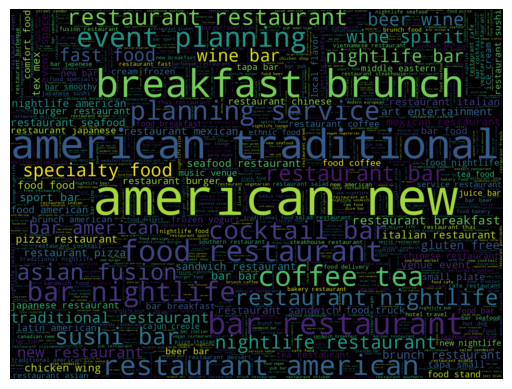

In [ ]:
# Wordcloud of lemmatized categories
text_data = ' '.join([item for sublist in sampled_pre_df.select("lemmatized").rdd.flatMap(lambda x: x).collect() for item in sublist])
#category_counts = Counter(text_data)  # Creates a dictionary: {'Restaurant': 50, 'Cafe': 20, ...}

# Generate WordCloud using frequency data
wordcloud = WordCloud(width=1440, height=1080, max_words=1000).generate(text_data)


# Display the updated word cloud
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [ ]:

post_df_cat = post_lem_df.withColumn("category", explode(col("lemmatized")))
pre_df_cat = sampled_pre_df.withColumn("category", explode(col("lemmatized")))
print("Top categories post COVID")
post_df_cat.groupBy("category").agg(count("*").alias("review_count"),avg("customer_stars").alias("avg_rating")) \
    .orderBy("review_count", ascending=False) \
    .show(20, truncate=False)
print("Top categories pre COVID")
pre_df_cat.groupBy("category").agg(count("*").alias("review_count"),avg("customer_stars").alias("avg_rating")) \
    .orderBy("review_count", ascending=False) \
    .show(20, truncate=False)

Top categories post COVID
+-----------+------------+------------------+
|category   |review_count|avg_rating        |
+-----------+------------+------------------+
|restaurant |401009      |3.8719529985611296|
|food       |218285      |3.8880820945094716|
|bar        |213037      |3.940925754681112 |
|american   |133220      |3.8231271580843718|
|nightlife  |106281      |3.9093817333295697|
|breakfast  |64809       |3.9490965760928267|
|brunch     |64475       |3.951035284994184 |
|traditional|64295       |3.6974414806750135|
|new        |64114       |3.919518357924946 |
|sandwich   |51005       |3.898441329281443 |
|seafood    |43361       |3.860796568344826 |
|mexican    |41812       |3.7863532000382665|
|pizza      |38768       |3.7596987205943044|
|tea        |37179       |3.9850722181876868|
|event      |34475       |3.87211022480058  |
|coffee     |33064       |3.978103072828454 |
|burger     |32892       |3.478414204061778 |
|service    |32811       |3.876657218615708 |
|cocktai

## Reviews Word Cloud

In [ ]:
cleaned_precov_df = pre_df.withColumn("Reviews",
    regexp_replace(lower(pre_df["text_"]), "[^a-zA-Z0-9\s]", ""))

cleaned_precov_df.select("Reviews").show(5, truncate=False)

+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

In [ ]:
cleaned_postcov_df = post_df.withColumn("Reviews",
    regexp_replace(lower(post_df["text_"]), "[^a-zA-Z0-9\s]", ""))

cleaned_postcov_df.select("Reviews").show(5, truncate=False)

+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

In [ ]:
filtered_precov_df_sample = cleaned_precov_df.sample(fraction=0.001)

In [ ]:
filtered_precov_df_sample  = filtered_precov_df_sample .withColumn(
    "cleaned_reviews",
    when(col("Reviews").isNotNull(), regexp_replace("Reviews", "[\n,]+", ""))
    .otherwise("")  # Replace NULLs with an empty string
)

# Tokenize text into words
tokenized_precov_df = filtered_precov_df_sample .withColumn("words", split(col("cleaned_reviews"), " "))

# Remove stopwords
remover = StopWordsRemover(inputCol="words", outputCol="filtered_words_pre")
filtered_precov_df = remover.transform(tokenized_precov_df)

# Filter out empty lists after stopword removal
filtered_precov_df = filtered_precov_df.filter(
    (col("filtered_words_pre").isNotNull()) & (size(col("filtered_words_pre")) > 0)
)

# Show cleaned and filtered results
filtered_precov_df.select("filtered_words_pre").show(5, truncate=False)

ERROR:root:KeyboardInterrupt while sending command.
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/py4j/java_gateway.py", line 1038, in send_command
    response = connection.send_command(command)
               ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/py4j/clientserver.py", line 511, in send_command
    answer = smart_decode(self.stream.readline()[:-1])
                          ^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/lib/python3.11/socket.py", line 718, in readinto
    return self._sock.recv_into(b)
           ^^^^^^^^^^^^^^^^^^^^^^^
KeyboardInterrupt


KeyboardInterrupt: 

In [ ]:
from pyspark.sql.functions import split, regexp_replace
from pyspark.ml.feature import StopWordsRemover

# Remove \n\n and replace with a space
cleaned_postcov_df = cleaned_postcov_df.withColumn(
    "cleaned_reviews", regexp_replace("Reviews", "\n+", " ")  # Replaces multiple newlines with a space
)

# Tokenize text into words
tokenized_postcov_df = cleaned_postcov_df.withColumn("words", split("cleaned_reviews", " "))

# Remove stopwords
remover = StopWordsRemover(inputCol="words", outputCol="filtered_words_post")
filtered_postcov_df = remover.transform(tokenized_postcov_df)

# Show result
filtered_postcov_df.select("filtered_words_post").show(5, truncate=False)


+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Pre Covid Reviews

Positive

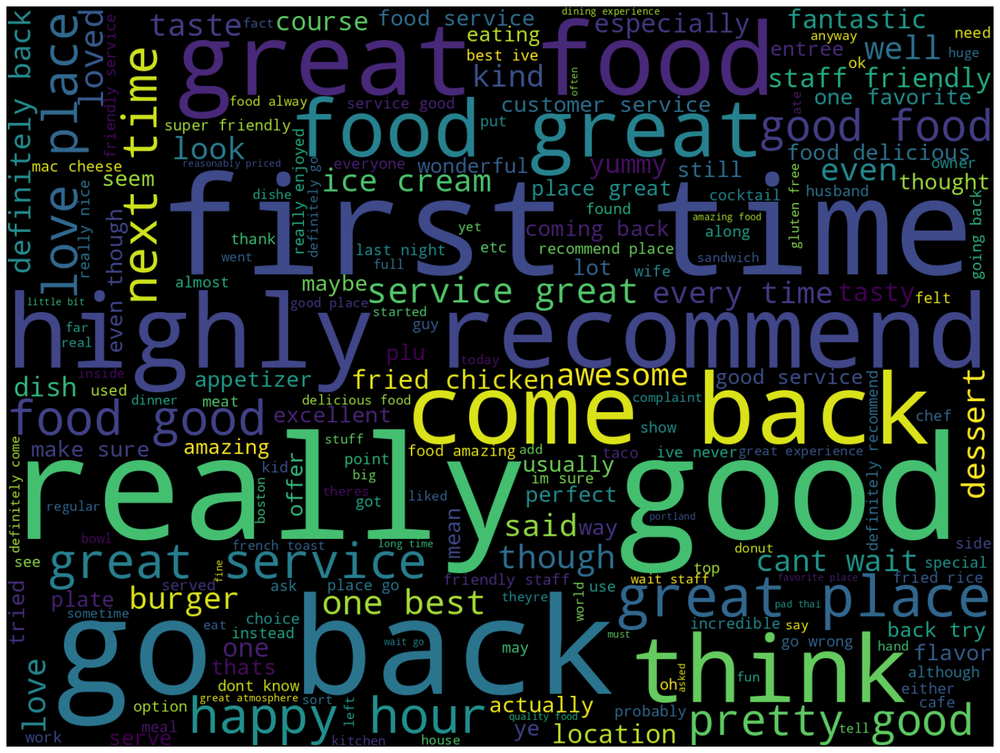

In [ ]:
# Good reviews
pre_df_positive = filtered_precov_df.filter(col("customer_stars")>=4).sample(fraction=0.1,seed=42)

# Top words post Covid for satisfied customers
# Convert Spark DataFrame to Pandas (collecting only the text column)
text_data_pre = ' '.join([item for sublist in pre_df_positive.select("filtered_words_pre").rdd.flatMap(lambda x: x).collect() for item in sublist])

# Generate the word cloud
cloud_pre = WordCloud(width=1440, height=1080, max_words=200).generate(text_data_pre)

# Display the word cloud
plt.figure(figsize=(20, 15))
plt.imshow(cloud_pre, interpolation="bilinear")
plt.axis('off')
plt.show()

Neutral

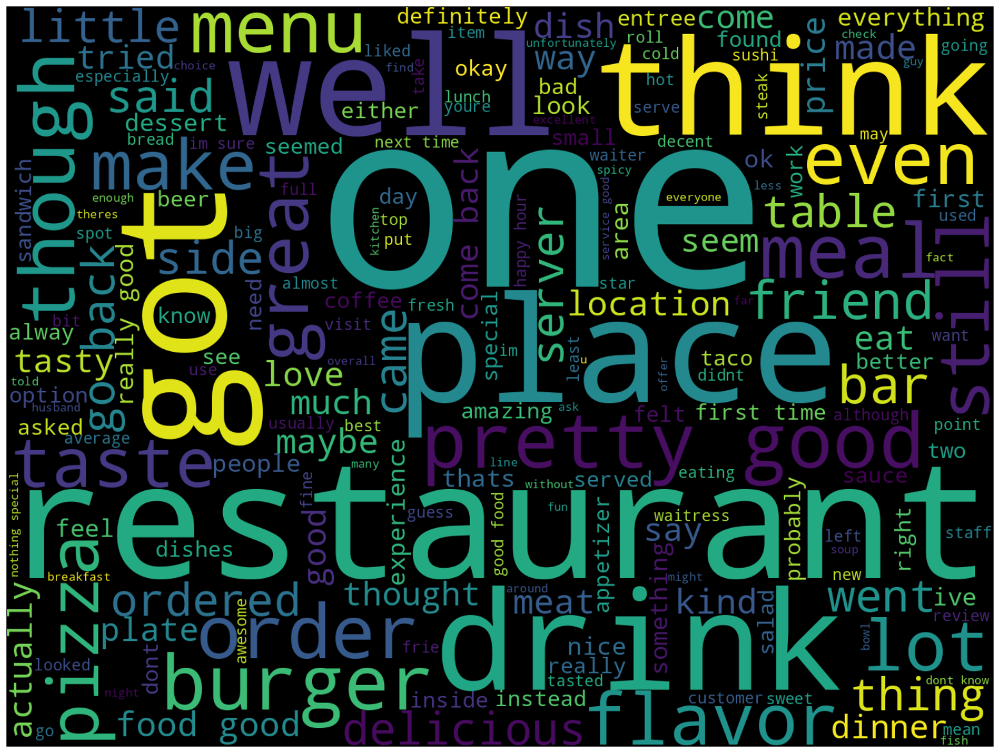

In [ ]:
# Neutral reviews
pre_df_neutral = filtered_precov_df.filter(col("customer_stars") == 3).sample(fraction=0.1,seed=42)

# Top words post Covid for satisfied customers
# Convert Spark DataFrame to Pandas (collecting only the text column)
text_data_pre_neutral = ' '.join([item for sublist in pre_df_neutral.select("filtered_words_pre").rdd.flatMap(lambda x: x).collect() for item in sublist])

# Generate the word cloud
cloud_pre_neutral = WordCloud(width=1440, height=1080, max_words=200).generate(text_data_pre_neutral)

# Display the word cloud
plt.figure(figsize=(20, 15))
plt.imshow(cloud_pre_neutral, interpolation="bilinear")
plt.axis('off')
plt.show()

Negative

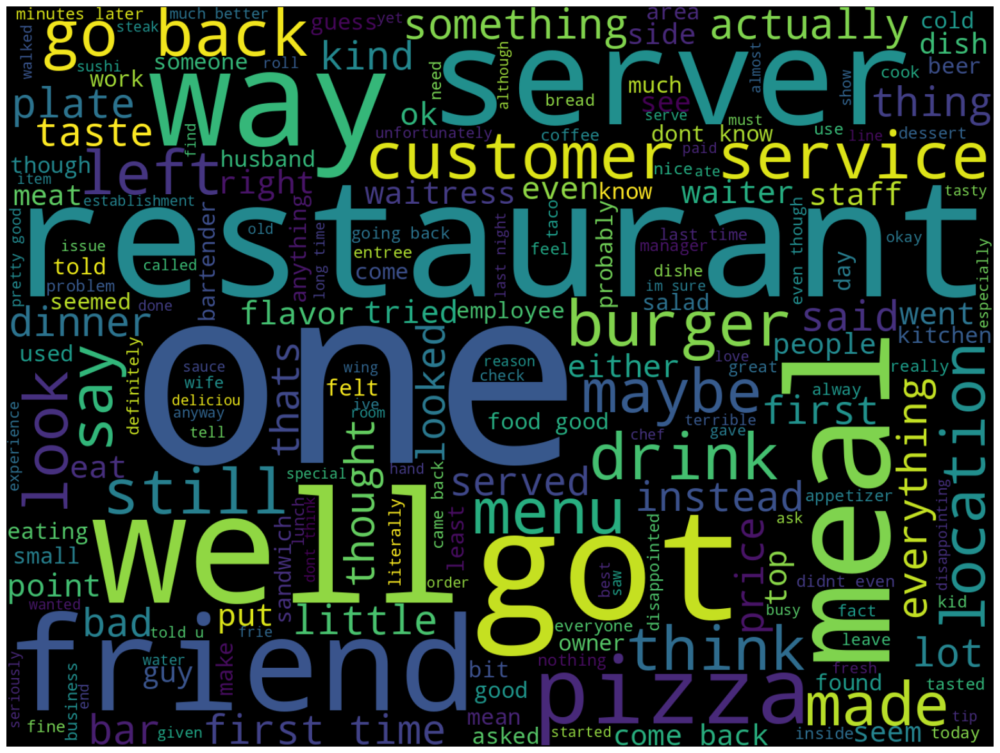

In [ ]:
# Negative reviews
pre_df_negative = filtered_precov_df.filter(col("customer_stars") < 3).sample(fraction=0.1,seed=42)

# Convert Spark DataFrame to Pandas (collecting only the text column)
text_data_pre_neg = ' '.join([item for sublist in pre_df_negative.select("filtered_words_pre").rdd.flatMap(lambda x: x).collect() for item in sublist])

# Generate the word cloud
cloud_pre_neg = WordCloud(width=1440, height=1080, max_words=200).generate(text_data_pre_neg)

# Display the word cloud
plt.figure(figsize=(20, 15))
plt.imshow(cloud_pre_neg, interpolation="bilinear")
plt.axis('off')
plt.show()

Post Covid Reviews

Positive

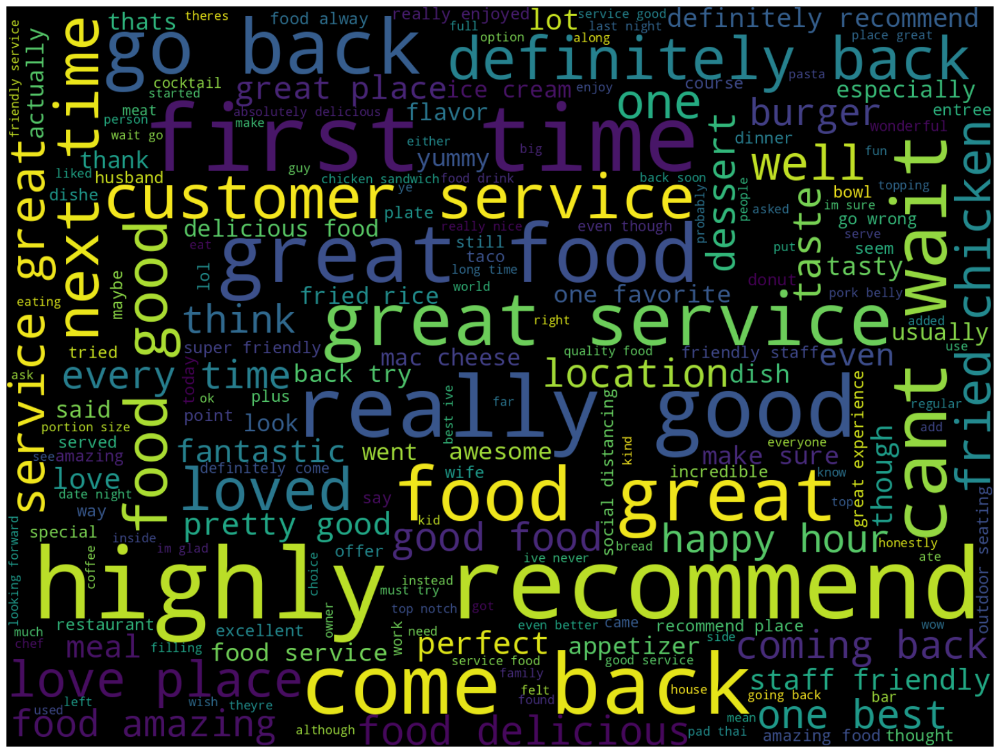

In [ ]:
# Good reviews
post_df_positive = filtered_postcov_df.filter(col("customer_stars")>=4)

# Top words post Covid for satisfied customers
# Convert Spark DataFrame to Pandas (collecting only the text column)
text_data_post = ' '.join([item for sublist in post_df_positive.select("filtered_words_post").rdd.flatMap(lambda x: x).collect() for item in sublist])

# Generate the word cloud
cloud_post = WordCloud(width=1440, height=1080, max_words=200).generate(text_data_post)

# Display the word cloud
plt.figure(figsize=(20, 15))
plt.imshow(cloud_post, interpolation="bilinear")
plt.axis('off')
plt.show()

Neutral

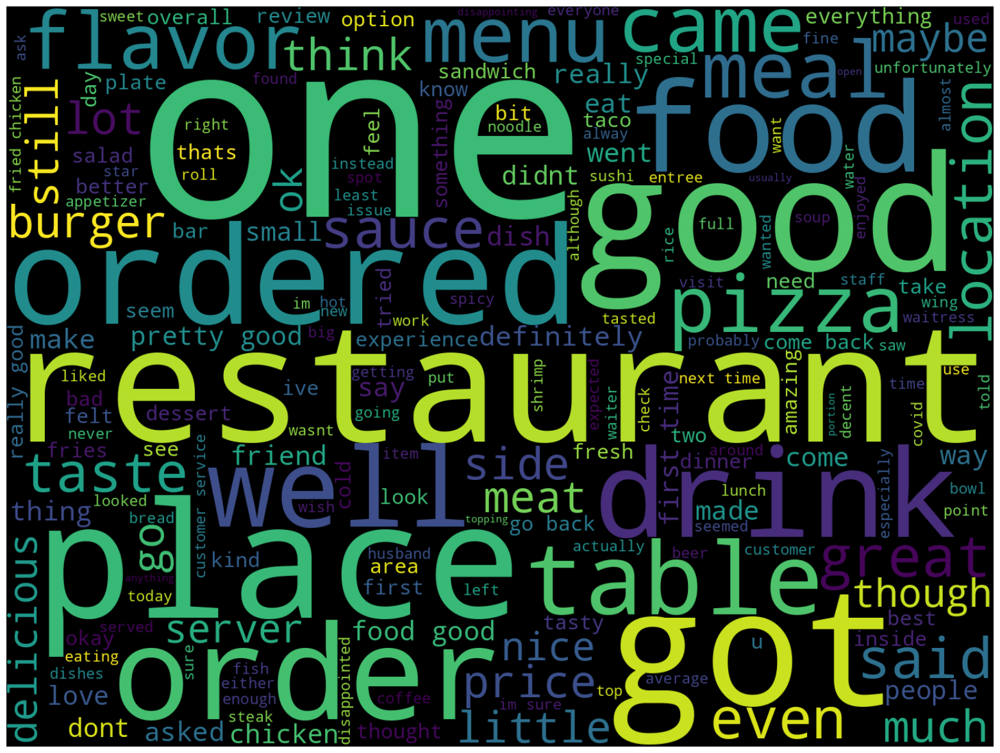

In [ ]:
# Neutral reviews
post_df_neutral = filtered_postcov_df.filter(col("customer_stars")==3)

# Top words post Covid for satisfied customers
# Convert Spark DataFrame to Pandas (collecting only the text column)
text_data_post_neutral = ' '.join([item for sublist in post_df_neutral.select("filtered_words_post").rdd.flatMap(lambda x: x).collect() for item in sublist])

# Generate the word cloud
cloud_post_neutral = WordCloud(width=1440, height=1080, max_words=200).generate(text_data_post_neutral)

# Display the word cloud
plt.figure(figsize=(20, 15))
plt.imshow(cloud_post_neutral, interpolation="bilinear")
plt.axis('off')
plt.show()

Negative

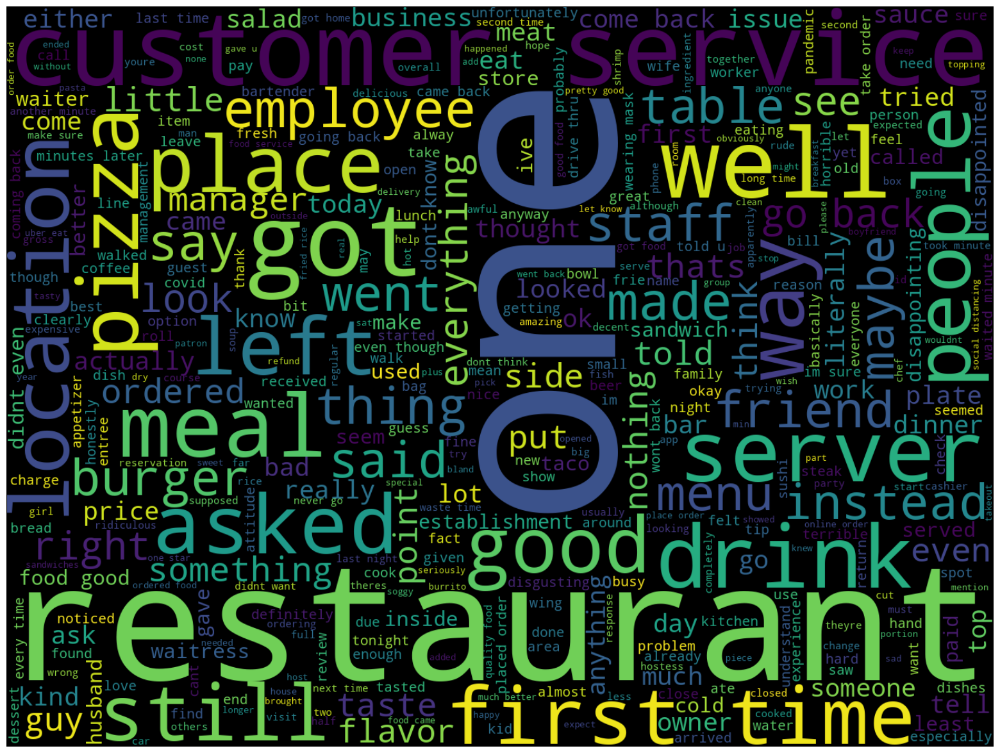

In [ ]:
# Good reviews
post_df_negative = filtered_postcov_df.filter(col("customer_stars") <=2)

# Top words post Covid for satisfied customers
# Convert Spark DataFrame to Pandas (collecting only the text column)
text_data_post_neg = ' '.join([item for sublist in post_df_negative.select("filtered_words_post").rdd.flatMap(lambda x: x).collect() for item in sublist])

# Generate the word cloud
cloud_post = WordCloud(width=1440, height=1080, max_words=400).generate(text_data_post_neg)

# Display the word cloud
plt.figure(figsize=(20, 15))
plt.imshow(cloud_post, interpolation="bilinear")
plt.axis('off')
plt.show()

Topic ID:0

donuts
open
one
two
dont
room
place
------------------
Topic ID:1
food
order
location
time
get

service
one
------------------
Topic ID:2

food
chicken
ordered
like
good
place
got
------------------
Topic ID:3
cobbler
pok
place
order
peach
food
wedding
like
------------------
Topic ID:4
food
place
good
sushi

service
dont
like
------------------
Topic ID:5
pizza
coffee

ordered
order
cheese
food
go
------------------
Topic ID:6
order

food
time
said
minutes
service
get
------------------
Topic ID:7
burger
back
like
food
didnt
ordered
hair

------------------
Topic ID:8
mask
wearing
food
masks

customers
people
one
------------------
Topic ID:9

food
us
table
service
came
time
one
------------------
Topic 0


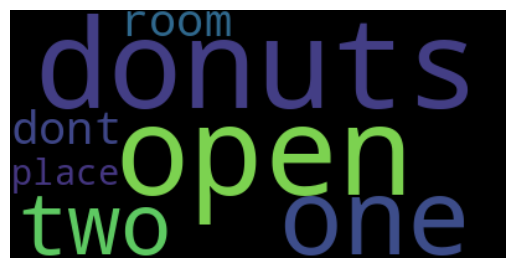

Topic 1


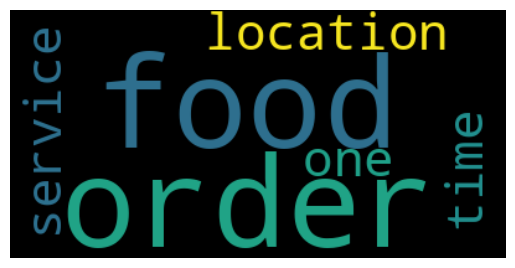

Topic 2


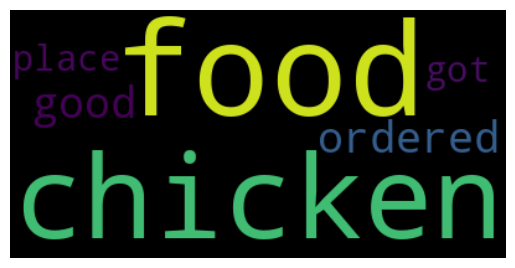

Topic 3


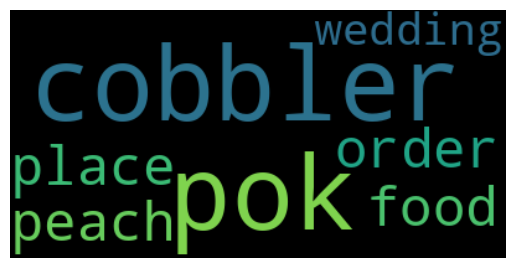

Topic 4


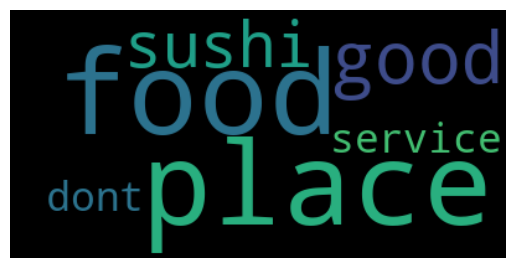

Topic 5


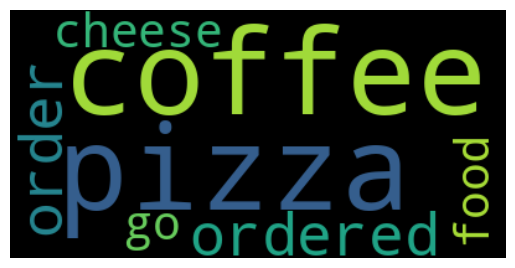

Topic 6


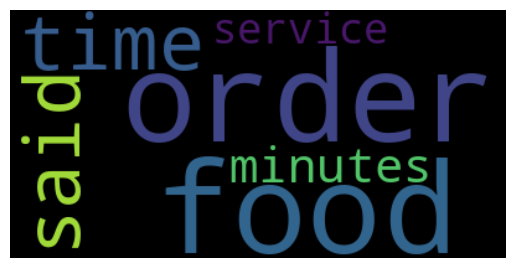

Topic 7


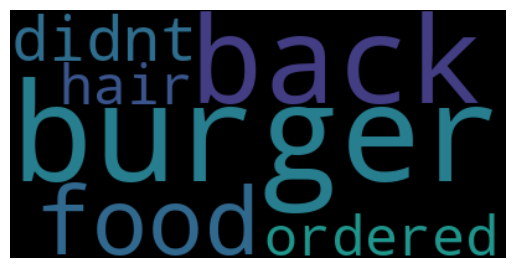

Topic 8


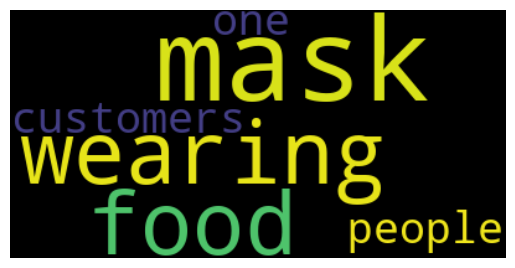

Topic 9


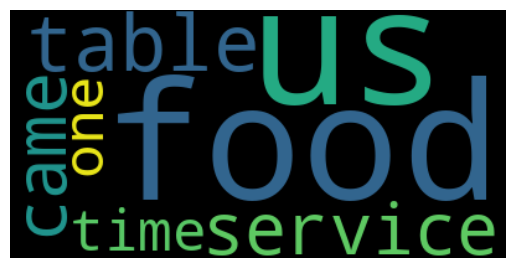

In [ ]:
# Topic Modeling for closed restaurants
from pyspark.ml.clustering import LDA
from pyspark.ml.feature import CountVectorizer
from pyspark.ml import Pipeline

# Tokenize and remove stopwords (same as before)
cv = CountVectorizer(inputCol="filtered_words_post", outputCol="raw_features", vocabSize=5000, minDF=10.0)
cvmodel = cv.fit(post_df_negative)
result_cv = cvmodel.transform(post_df_negative)
idf = IDF(inputCol="raw_features", outputCol="features")
idfModel = idf.fit(result_cv)
result_tfidf = idfModel.transform(result_cv)

# Apply LDA for topic modeling
lda = LDA(k=10,featuresCol="raw_features",seed=42)
lda_model = lda.fit(result_tfidf)
lda_result = lda_model.transform(result_tfidf)

# Now to print our topics:
topicIndices = lda_model.describeTopics(maxTermsPerTopic = 8)
vocabList = cvmodel.vocabulary

# we print the final topics
for topic in topicIndices.collect():
    print("Topic ID:" + str(topic["topic"]))
    for term in topic["termIndices"]:
        print(vocabList[term])
    print("------------------")


# AND Create a word cloud plot
# Convert the indices to words
from wordcloud import WordCloud
from matplotlib import pyplot as plt

# For each topic indice get the word
word_topic = topicIndices.rdd.map(lambda row: [vocabList[i] for i in row.termIndices]).collect()

# Generate the word cloud for each topic
for i in range(len(word_topic)):
    print("Topic {}".format(i))
    wordcloud = WordCloud().generate(" ".join(word_topic[i]))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

## Closed Restaurants

In [ ]:
closed_restaurants = filtered_postcov_df.filter(col("is_open") == 0)
closed_restaurants.show()

+--------------------+--------------------+--------------------+------+-----------+-----------+-------------+---------------+-----+------------+-------+--------------------+--------------------+--------------------+--------------------+--------------+------+-----+----+--------------------+-------------------+--------------------+--------------------+--------------------+--------------------+
|         business_id|                name|             address|state_|       city|postal_code|     latitude|      longitude|stars|review_count|is_open|          categories|               hours|           review_id|             user_id|customer_stars|useful|funny|cool|               text_|              date_|             Reviews|     cleaned_reviews|               words| filtered_words_post|
+--------------------+--------------------+--------------------+------+-----------+-----------+-------------+---------------+-----+------------+-------+--------------------+--------------------+----------------

In [ ]:
closed_restaurants.groupBy("stars").agg(countDistinct("business_id")).show()

+-----+---------------------------+
|stars|count(DISTINCT business_id)|
+-----+---------------------------+
|  3.5|                        458|
|  4.5|                        307|
|  2.5|                        112|
|  4.0|                        595|
|  3.0|                        278|
|  2.0|                         48|
|  1.5|                         21|
|  5.0|                         46|
+-----+---------------------------+



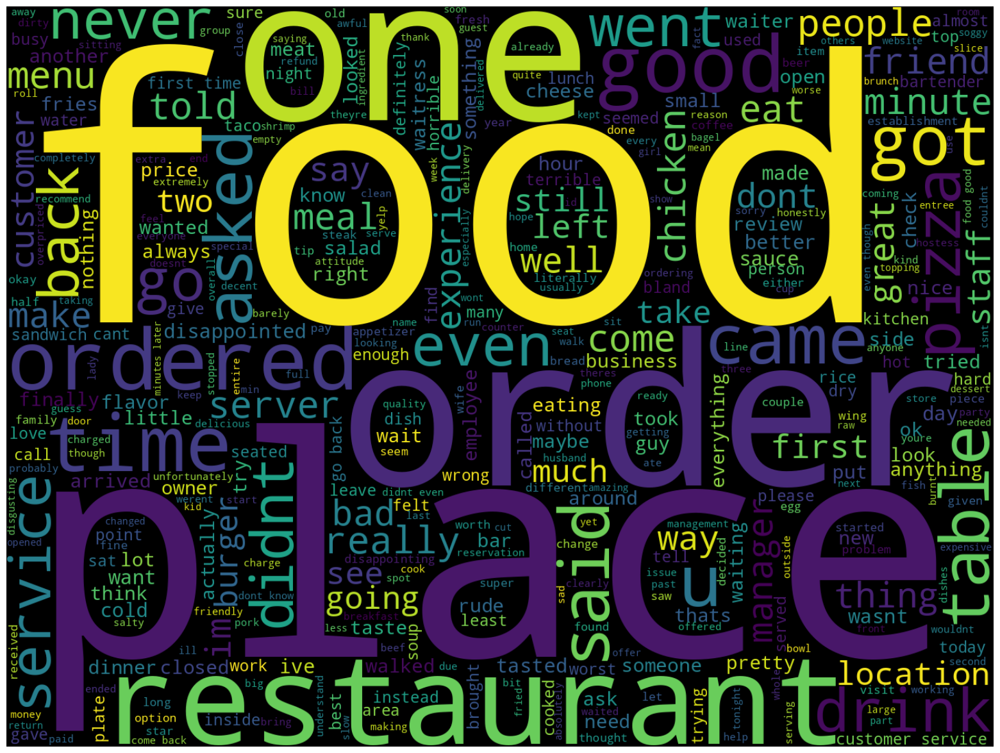

In [ ]:
# reviews of closed restaurants
# Convert Spark DataFrame to Pandas (collecting only the text column)
closed_restaurants_negative = closed_restaurants.filter(col('customer_stars')<= 2)
text_data_closed = ' '.join([item for sublist in closed_restaurants_negative.select("filtered_words_post").rdd.flatMap(lambda x: x).collect() for item in sublist])

# Generate the word cloud
cloud_post = WordCloud(width=1440, height=1080, max_words=400).generate(text_data_closed)

# Display the word cloud
plt.figure(figsize=(20, 15))
plt.imshow(cloud_post, interpolation="bilinear")
plt.axis('off')
plt.show()

Topic ID:0

food
us
back
place
------------------
Topic ID:1
order
food

like
time
------------------
Topic ID:2

food
like
place
ordered
------------------
Topic ID:3
bowls
la
bowl
de
ice
------------------
Topic ID:4

got
food
table
said
------------------
Topic 0


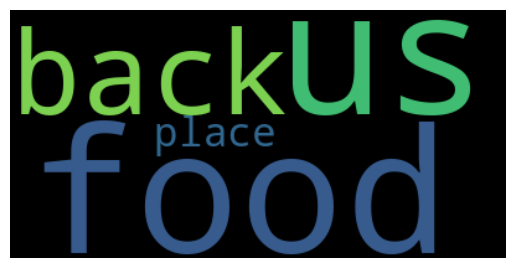

Topic 1


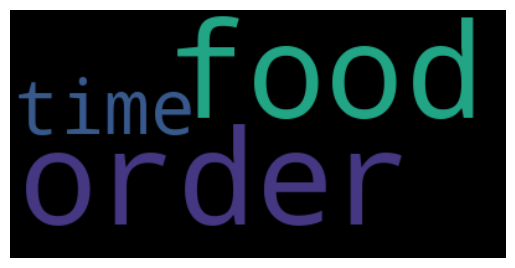

Topic 2


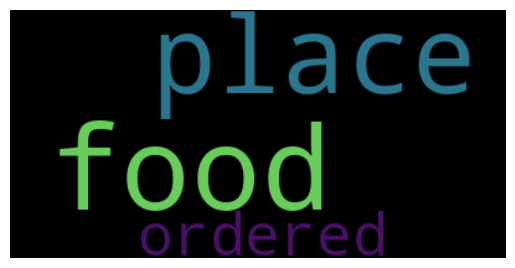

Topic 3


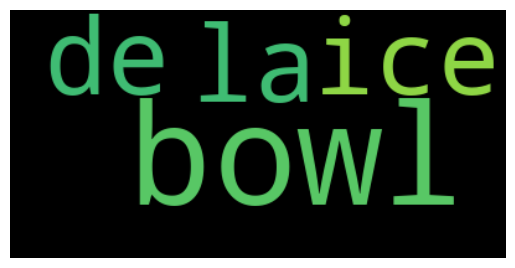

Topic 4


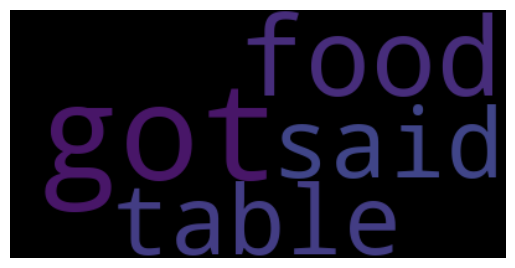

In [ ]:
# Topic Modeling for closed restaurants
from pyspark.ml.clustering import LDA
from pyspark.ml.feature import CountVectorizer
from pyspark.ml import Pipeline

# Tokenize and remove stopwords (same as before)
cv = CountVectorizer(inputCol="filtered_words_post", outputCol="raw_features", vocabSize=5000, minDF=10.0)
cvmodel = cv.fit(closed_restaurants_negative)
result_cv = cvmodel.transform(closed_restaurants_negative)
idf = IDF(inputCol="raw_features", outputCol="features")
idfModel = idf.fit(result_cv)
result_tfidf = idfModel.transform(result_cv)

# Apply LDA for topic modeling
lda = LDA(k=5, maxIter=10, featuresCol="raw_features")
lda_model = lda.fit(result_tfidf)
lda_result = lda_model.transform(result_tfidf)

# Now to print our topics:
topicIndices = lda_model.describeTopics(maxTermsPerTopic = 5)
vocabList = cvmodel.vocabulary

# we print the final topics
for topic in topicIndices.collect():
    print("Topic ID:" + str(topic["topic"]))
    for term in topic["termIndices"]:
        print(vocabList[term])
    print("------------------")


# AND Create a word cloud plot
# Convert the indices to words
from wordcloud import WordCloud
from matplotlib import pyplot as plt

# For each topic indice get the word
word_topic = topicIndices.rdd.map(lambda row: [vocabList[i] for i in row.termIndices]).collect()

# Generate the word cloud for each topic
for i in range(len(word_topic)):
    print("Topic {}".format(i))
    wordcloud = WordCloud().generate(" ".join(word_topic[i]))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

Check how many restaurants closed in each state

In [ ]:
closed_by_location = closed_restaurants.groupBy("state_").agg(countDistinct("business_id").alias("count"))
closed_by_location.show()

+------+-----+
|state_|count|
+------+-----+
|    OR|  370|
|    BC|  188|
|    WA|   29|
|    OH|  155|
|    TX|  272|
|    GA|  271|
|    MA|  392|
|    FL|  308|
|    CO|   32|
+------+-----+



Text(0.5, 0, 'state')

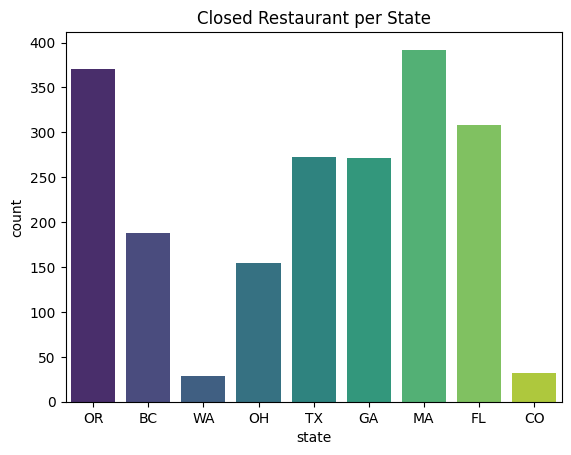

In [ ]:
sns.barplot(x="state_", y = "count" , data = closed_by_location.toPandas(),palette = "viridis")
plt.title("Closed Restaurant per State")
plt.xlabel("state")

In [ ]:
# Calculate review counts for closed restaurants per month
closed_reviews_by_month = closed_restaurants.groupBy("business_id", month("date_").alias("month"), year("date_").alias("year")) \
    .agg(count("text_").alias("review_count"))

# For visualization, we can order by restaurant name and then by year/month
closed_reviews_by_month = closed_reviews_by_month.orderBy( "year", "month")

closed_reviews_by_month.show()

+--------------------+-----+----+------------+
|         business_id|month|year|review_count|
+--------------------+-----+----+------------+
|IDpBC683e9gIb7FkH...|    1|2020|           1|
|0TuEReBe1Ar0ag-4L...|    1|2020|           1|
|9ylWOjNH4ldduzaF0...|    1|2020|           1|
|o3EOOa-Rt--zHmC9R...|    1|2020|           1|
|yAeLNchEL8in-6Zvb...|    1|2020|           1|
|4YFSmyN_VjGjL9Yie...|    1|2020|           1|
|vrENO0JEI3UnkzMaJ...|    1|2020|           7|
|3R88s8EqSxaVkz7YV...|    1|2020|           5|
|irTusp4eF-PoyDiqq...|    1|2020|           1|
|WRXEgMB3nCCqwBvtq...|    1|2020|           1|
|btutp2Rc4zkTVL7_q...|    1|2020|           5|
|m4vftwiBn64QnkScu...|    1|2020|           2|
|p8ohzzGvGRCHnJKny...|    1|2020|          11|
|xuGwyEHN5TZtfAMg3...|    1|2020|           5|
|oIrLGMEloay2dOnlm...|    1|2020|           3|
|j9dEN8Bb05uaNghab...|    1|2020|           1|
|Eq9GdoZlMxw7bJZmq...|    1|2020|           3|
|5HAuhk6_h5t7j6fk9...|    1|2020|           4|
|rv2_jpzHnIYz

In [ ]:
closed_reviews_by_month.groupby("business_id","month").agg(max('year').alias('last_review')).orderBy("last_review",ascending = False).show()

+--------------------+-----+-----------+
|         business_id|month|last_review|
+--------------------+-----+-----------+
|4ZhuOt8VmWs7sEoUY...|   12|       2020|
|F3mkWiwfz_RN8zThI...|   12|       2020|
|HB_v0MY2QAs_05xpQ...|   12|       2020|
|Sf1r8dZGvGx2ZTs1d...|   12|       2020|
|-xcMZCICjtdSzJlDY...|   12|       2020|
|c2t4GFn3TNZOygYp-...|   12|       2020|
|peOqewZwX_glJLmUv...|   12|       2020|
|_u0MybBp6PQgQ38p6...|   12|       2020|
|goal-j-OY7wJhZ278...|   12|       2020|
|YSKy39ItRvsrZeM7y...|   12|       2020|
|yrRvAeXRwWsRIWfM9...|   12|       2020|
|LNVth1ToC8MkbQREl...|   12|       2020|
|gJWbeL6cDgcPvvZSn...|   12|       2020|
|Sa_760KgccflQVMSs...|   12|       2020|
|ffMLQ3IeCQamz7tAV...|   12|       2020|
|ZUAb3zLBBJP689gjJ...|   12|       2020|
|nlnWODemnfzut10tz...|   12|       2020|
|dIADMv4TVrObl9TaM...|   12|       2020|
|MPz24GZB_0r44tM9H...|   12|       2020|
|5TsjdwNt10gxGChQt...|   12|       2020|
+--------------------+-----+-----------+
only showing top

Categories with most closed restaurants

In [ ]:
# Explode category strings into arrays
category_df = closed_restaurants.withColumn("category", explode(split("categories", ", ")))

category_df.groupBy("category").agg(countDistinct("business_id").alias("count")).orderBy(col("count").desc()).show(15)


+--------------------+-----+
|            category|count|
+--------------------+-----+
|         Restaurants| 1865|
|                Food|  638|
|           Nightlife|  476|
|                Bars|  456|
|American (Traditi...|  309|
|          Sandwiches|  307|
|  Breakfast & Brunch|  294|
|      American (New)|  285|
|               Pizza|  200|
|             Burgers|  183|
|        Coffee & Tea|  177|
|               Salad|  156|
|             Italian|  150|
|             Seafood|  150|
|             Mexican|  136|
+--------------------+-----+
only showing top 15 rows



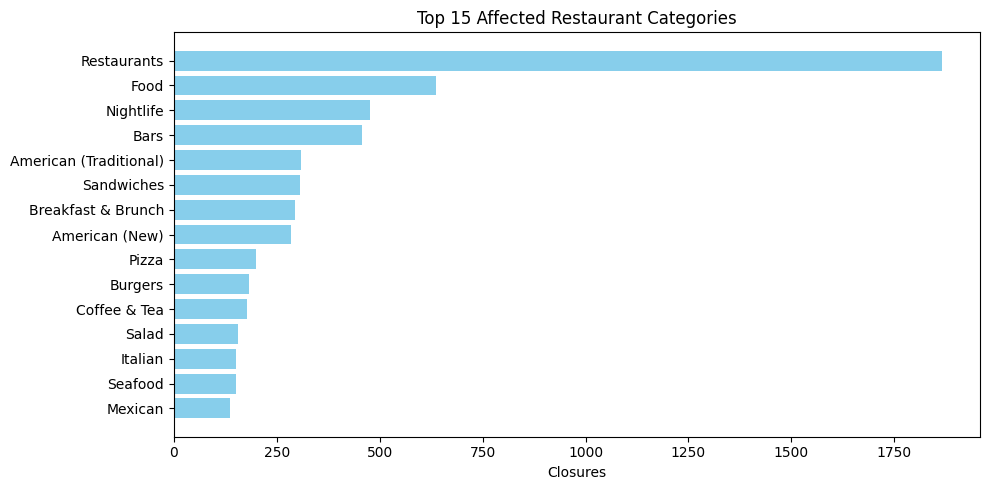

In [ ]:
top_categories_pd = category_df.groupBy("category").agg(countDistinct("business_id").alias("count")).orderBy(col("count").desc()).limit(15).toPandas()

plt.figure(figsize=(10, 5))
plt.barh(top_categories_pd['category'], top_categories_pd['count'], color='skyblue')
plt.title('Top 15 Affected Restaurant Categories')
plt.xlabel('Closures')
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

# Classification Modelling on Reviews column

We are going to perform sentiment analysis, through Logistic Regression, in order to predict the category at which each review of each customer falls.
1. We will first create a new columns that will be our label. This column will be called "customer_stars_category" and will be generated by the "customer_stars" as follows:
- if "customer_star" == 4 OR 5 => "customer_stars_category" == "Positive"
- if "customer_star" == 3 => "customer_stars_category" == "Neutral"
- if "customer_star" == 1 OR 2 => "customer_stars_category" == "Negative"

2. Then, we will filter out all the reviews that are not in English language.

3. The next step will be a preprocessing step of the "Reviews" column. We will do TF-IDF in order to measure the importance of each word in the reviews collection. We will start by tokenizing the text and removing stopwords. After we will create a CountVectorizer, fit & transform. This will allows us to convert text data into a numerical format snce it will generate a matrix of term frequency counts for each review. Finally, we will use IDF to weight the word frequencies.

4. Afterwards, we will continue with more pre-processing steps in other columns:
  - Changing to the correct province (Vancouver is in BC not ABE).
  - One-hot-encoding at the states column.

5. Then, we split the dataset in train(80%) and test(20%) datasets.

6. Then, we create the VectorAssembler that includes all the features that we will use to train the Logistic Regression model and label encode the label, "customer_stars_category" on train data.

7. Train anf fit Logistic Regression on train data.\
   *Note: we set elastic net regularization to 1. This way we use Lasso - L1 regularization, which it basically automatically performs feature selection by setting some feature coefficients to zero. Features with non-zero coefficients are the ones that the model has learned to be important for predicting the target variable.*

8. Create VectorAssembler for test data and label encode the label, "customer_stars_category" on test data.


9. Make predictions

10. Calculate metrics


*Note: The above process will be performed at a random sample of 10% of the pre-covid dataset*

In [ ]:
"""
First we start by taking a proportion of our dataset - we take the 10%
"""

sampled_pre_df3 = pre_df.sample(fraction=0.1, seed=42)

In [ ]:
"""
Printing schema of my sampled_pre_df dataset and shoe the first 5 cols
"""
sampled_pre_df3.printSchema()
#sampled_pre_df3.show(5)

In [ ]:
"""
1)
"""
"""
Creating a new column named "customer_stars_category" and categorizing customer_stars column as it follows: 1,2 => negative, 3 => neutral, 4,5 => positive
Then, cout how much i have from each category.
"""
from pyspark.sql.functions import when, col

sampled_pre_df3 = sampled_pre_df3.withColumn(
    "customer_stars_category",
    when(col("customer_stars").isin([4, 5]), "positive")
    .when(col("customer_stars").isin([1, 2]), "negative")
    .otherwise("neutral")
)

sampled_pre_df3.show(20, truncate=False)
sampled_pre_df3.groupBy("customer_stars_category").count().show()

In [ ]:
!pip install langdetect

In [ ]:
"""
2)
"""
"""
Filter out all non-Enlgish reviews from the "text_" columns
"""
from pyspark.sql.functions import udf
from pyspark.sql.types import StringType
from langdetect import detect, DetectorFactory
import langdetect

# Set seed for consistent results
DetectorFactory.seed = 42

# Define UDF to detect language
def detect_language(text):
    try:
        return detect(text)
    except:
        return "unknown"

detect_language_udf = udf(detect_language, StringType())

# Apply UDF to create a new column for language
sampled_pre_df3 = sampled_pre_df3.withColumn("language", detect_language_udf(sampled_pre_df3["text_"]))

# Filter the DataFrame to only include English-language reviews
sampled_pre_df3 = sampled_pre_df3.filter(sampled_pre_df3["language"] == "en")


# Show rows where the text is not English
#sampled_pre_df_with_sentiment.filter(sampled_pre_df_with_sentiment["language"] != "en").select("text_", "language").show()

In [ ]:
#sampled_pre_df3.show(10)

In [ ]:
"""
3) A)
"""
"""
We preprocess the review column ("text_") (1)
"""
"""
starting by tokenize and remove stop words from the reviews column
"""
sampled_pre_df_dataset_filtered3 = sampled_pre_df3.dropna() #filtering out NAs
tokenizer2 = RegexTokenizer(inputCol="text_", outputCol="words", pattern="\\W")

tokenized_raw3 = tokenizer2.transform(sampled_pre_df_dataset_filtered3)
print("--- tokenized reviews ---")
tokenized_raw3.select("words").show(5)

remover3 = StopWordsRemover(inputCol="words", outputCol="filtered")
df_cleaned3 = remover3.transform(tokenized_raw3)
print("--- remove stop words from reviews ---")
df_cleaned3.select("filtered").show(5)

In [ ]:
"""
3) B)
"""
"""
Now, we create a CountVectorizer, fit & transform
This will allows us to convert text data into a numerical format.
It will generate a matrix of term frequency counts for each review
"""
"""
For CountVectorizer we use as input the column that was the output from the StopWordsRemover. In addition, set vocabSize=5000, minDF=10.0
"""
from pyspark.ml.feature import CountVectorizer

cv3 = CountVectorizer(inputCol="filtered", outputCol="raw_features", vocabSize=5000, minDF=10.0)
cvmodel3 = cv3.fit(df_cleaned3)
result_cv3 = cvmodel3.transform(df_cleaned3)
#result_cv3.show(5)

In [ ]:
"""
3) C)
"""
"""
Continue with preprocess of Reviews column (3)
Here, we use IDF to weight the word frequencies.
"""
idf3 = IDF(inputCol="raw_features", outputCol="reviews")
idfModel3 = idf3.fit(result_cv3)
result_tfidf3 = idfModel3.transform(result_cv3)
#result_tfidf3.show(5)

In [ ]:
"""
4) A)
"""
"""
Changing to the correct province
"""
result_tfidf3=result_tfidf3.withColumn("state_",
                          when((col("state_") == "ABE") & (col("city") == "Vancouver"), "BC")
    .otherwise(col("state_"))
)

In [ ]:
"""
4) B)
"""
"""
state_: Apply one-hot encoding at the "states" column
"""
from pyspark.ml.feature import OneHotEncoder
states = [("MN",), ("OR",), ("KY",), ("BC",), ("NH",), ("WA",), ("OH",), ("TX",),("GA",), ("MA",), ("KS",), ("FL",), ("CO",)]
states_df = spark.createDataFrame(states, ["state_"])

states_indexer = StringIndexer(inputCol="state_", outputCol="state_index")

states_encoder = OneHotEncoder(inputCol="state_index", outputCol="state_ohe")

pipeline = Pipeline(stages=[states_indexer, states_encoder])

pipeline_model = pipeline.fit(states_df)
df_encoded = pipeline_model.transform(states_df)
result_tfidf3 = result_tfidf3.join(
    df_encoded.select("state_", "state_index", "state_ohe"),
    on="state_",
    how="left"
)

In [ ]:
"""
5)
"""
"""
We split to train and test
"""
train_data, test_data = result_tfidf3.randomSplit([0.8, 0.2], seed=42)

In [ ]:
"""
6)
"""
"""
We create the VectorAssembler that includes all the features on train data
"""
assembler_lr = VectorAssembler(
    inputCols=["latitude","longitude","useful","funny","cool","review_count","stars", "state_ohe", "is_open","reviews"],
    outputCol="all_features"
)
df_final_train = assembler_lr.transform(train_data)

In [ ]:
#df_final_train.show(5)

In [ ]:
#Label Encoding the "customer_stars_category"
df_final_train = df_final_train.withColumn(
    "customer_stars_category_labeled",when((col("customer_stars_category") == "positive"), 0).when((col("customer_stars_category") == "neutral"), 1).otherwise(2)
)

In [ ]:
"""
7)
"""
"""
Perform logistic regression
"""
#Train logistic regression
from pyspark.ml.classification import LogisticRegression

lr = LogisticRegression(maxIter=15,regParam=0.03,elasticNetParam=1,featuresCol="all_features", labelCol="customer_stars_category_labeled")
lr_model = lr.fit(df_final_train)

In [ ]:
"""
8)
"""
"""
We create the VectorAssembler that includes all the features on test data
"""
assembler_lr_test = VectorAssembler(
    inputCols=["latitude","longitude","useful","funny","cool","review_count","stars", "state_ohe", "is_open","reviews"],
    outputCol="all_features"
)
df_final_test = assembler_lr_test.transform(test_data)

In [ ]:
df_final_test = df_final_test.withColumn(
    "customer_stars_category_labeled",when((col("customer_stars_category") == "positive"), 0).when((col("customer_stars_category") == "neutral"), 1).otherwise(2)
)

In [ ]:
"""
9)
"""
"""
Make predictions
"""

predictions = lr_model.transform(df_final_test)
predictions.select("customer_stars_category_labeled", "prediction").show(10)

In [ ]:
"""
10)
"""
"""
Calculate metrics
"""
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
evaluator = MulticlassClassificationEvaluator(labelCol="customer_stars_category_labeled",
                                              predictionCol="prediction",
                                              metricName="f1")

f1_score = evaluator.evaluate(predictions)

print(f"Test F1-score: {f1_score}")